In [1]:
import tensorflow as tf
import numpy as np
import pandas as pd

import autoencoder_train
import network
import utils

In [2]:
datadir = "/home/cjw/disk2cjw/Data/nucleolus/"
#datadir = "/home/cjw/disk2cjw/Data/yeast/"
mmfilename = datadir + "memmaps/plate03_all.mm"
#mmfilename = datadir + "mmplate15-1.mm"
mmheader = np.memmap(mmfilename, dtype="int32", mode='r',
                    shape=(4,))

header_shape = mmheader.shape
print(header_shape, mmheader)
xshape = [mmheader[0], mmheader[1], mmheader[2], mmheader[3]]
xshape[0] = 2400
xshape = tuple(xshape)
del mmheader
print(xshape)

m3 = np.memmap(mmfilename, dtype='float32', offset=128,
              mode='r', shape=xshape)

mmf4 = datadir + "memmaps/plate04_all.mm"
mmf4header = np.memmap(mmf4, dtype="int32", mode='r',
                    shape=(4,))

print(mmf4header)
xshape4 = tuple([mmf4header[0], mmf4header[1], mmf4header[2], mmf4header[3]])
del mmf4header
m4 = np.memmap(mmf4, dtype='float32', offset=128,
              mode='r', shape=xshape4)

(4,) [94006  1080  1080     3]
(2400, 1080, 1080, 3)
[2400 1080 1080    3]


In [3]:
# datadir = "/home/cjw/disk2cjw/Data/nucleolus/"
datafile3 = datadir + "plate03_all_cells.csv"
datafile4 = datadir + "plate04_all_cells.csv"
#datafile = datadir + "plate15_cells.csv"
p_df3 = utils.read_data_file(datafile3)
p_df4 = utils.read_data_file(datafile4)
p_df = pd.concat([p_df3, p_df4])

p_df['id'] = range(len(p_df))


p_df.head()

,id,fid,file,mmfile,plate,row,column,field,yc,xc,well
0,0,0,/Volumes/projects/jru/public/tpo/Nucleolar mo...,plate03_all.mm,3,9,4,4,82.11,293.56,50
1,1,0,/Volumes/projects/jru/public/tpo/Nucleolar mo...,plate03_all.mm,3,9,4,4,122.72,227.74,50
2,2,0,/Volumes/projects/jru/public/tpo/Nucleolar mo...,plate03_all.mm,3,9,4,4,122.36,1006.03,50
3,3,0,/Volumes/projects/jru/public/tpo/Nucleolar mo...,plate03_all.mm,3,9,4,4,123.55,940.51,50
4,4,0,/Volumes/projects/jru/public/tpo/Nucleolar mo...,plate03_all.mm,3,9,4,4,145.57,751.82,50


Encoder True
[<tf.Tensor 'Placeholder:0' shape=(?, 64, 64, 1) dtype=float32>, <tf.Tensor 'dropout/mul:0' shape=(?, 32, 32, 64) dtype=float32>, <tf.Tensor 'dropout_1/mul:0' shape=(?, 16, 16, 128) dtype=float32>, <tf.Tensor 'dropout_2/mul:0' shape=(?, 8, 8, 256) dtype=float32>, <tf.Tensor 'dropout_3/mul:0' shape=(?, 4, 4, 512) dtype=float32>] Tensor("latent_space/BiasAdd:0", shape=(?, 256), dtype=float32)
isize:  4 64
[<tf.Tensor 'dropout_4/mul:0' shape=(?, 8192) dtype=float32>, <tf.Tensor 'Reshape:0' shape=(?, 4, 4, 512) dtype=float32>, <tf.Tensor 'dropout_5/mul:0' shape=(?, 8, 8, 256) dtype=float32>, <tf.Tensor 'dropout_6/mul:0' shape=(?, 16, 16, 128) dtype=float32>, <tf.Tensor 'dropout_7/mul:0' shape=(?, 32, 32, 64) dtype=float32>] Tensor("decoder_out/BiasAdd:0", shape=(?, 64, 64, 1), dtype=float32)
Epoch:  0 Iteration:  0 Loss:  886.063


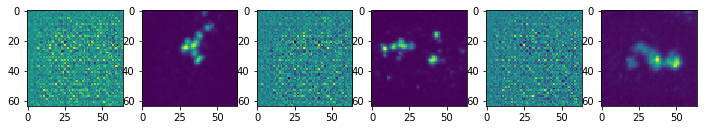

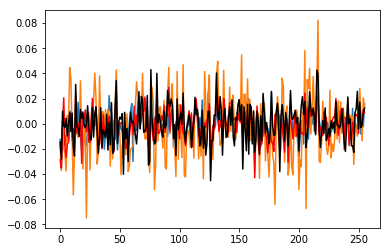

Epoch:  0 Iteration:  500 Loss:  19.515


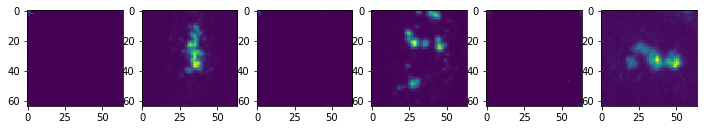

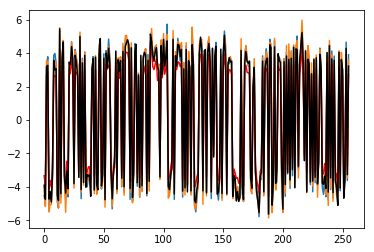

Epoch:  0 Iteration:  1000 Loss:  15.4384


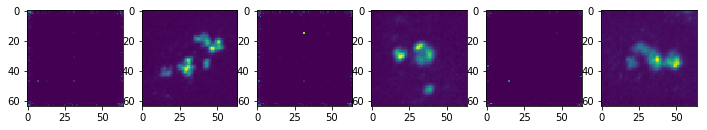

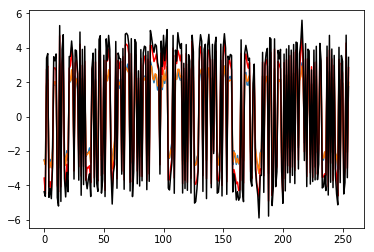

Epoch:  0 Iteration:  1500 Loss:  13.8472


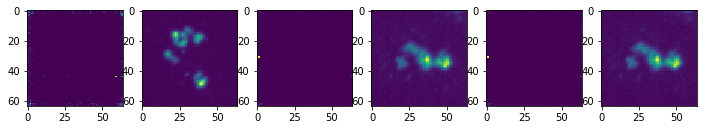

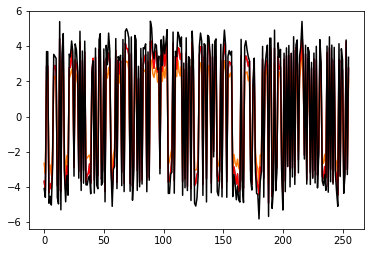

Epoch:  0 Iteration:  2000 Loss:  22.7511


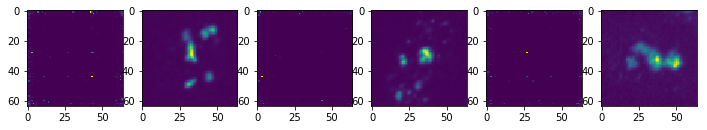

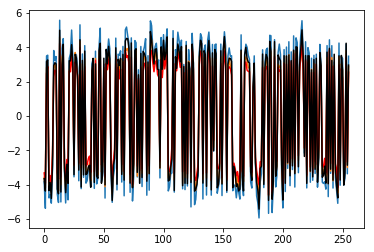

Epoch:  0 Iteration:  2500 Loss:  10.1


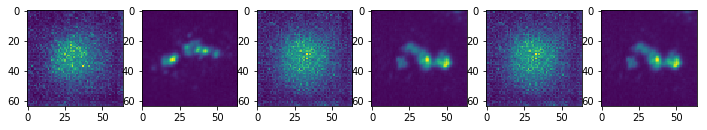

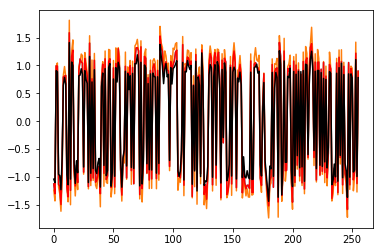

Epoch:  0 Iteration:  3000 Loss:  7.02888


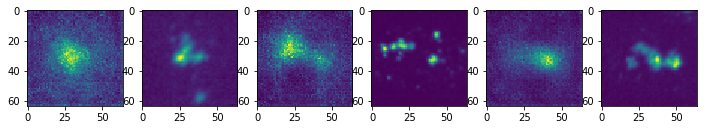

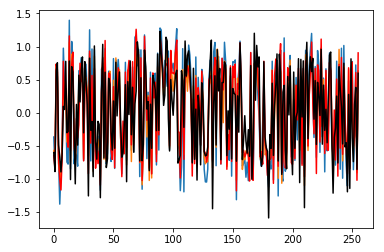

Epoch:  0 Iteration:  3500 Loss:  4.65347


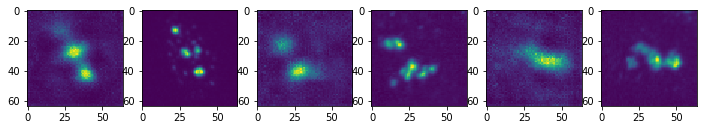

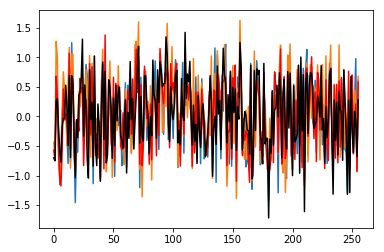

Epoch:  0 Iteration:  4000 Loss:  4.25246


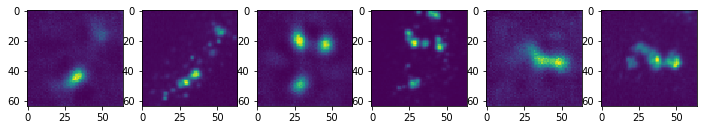

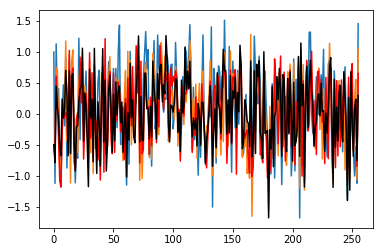

Epoch:  0 Iteration:  4500 Loss:  3.91546


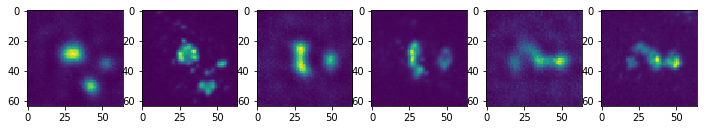

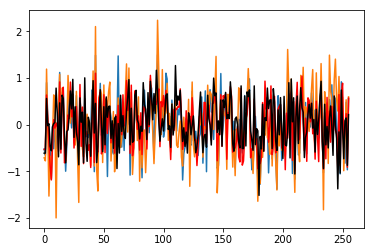

Epoch:  0 Iteration:  5000 Loss:  3.14571


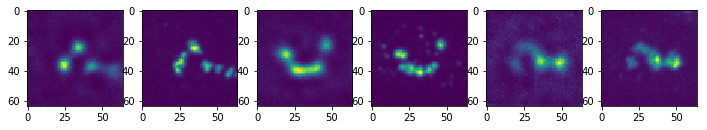

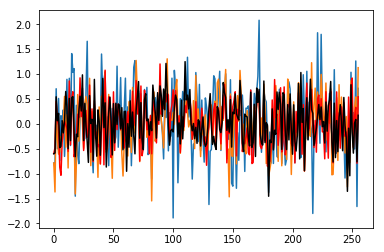

Epoch:  0 Iteration:  5500 Loss:  2.37634


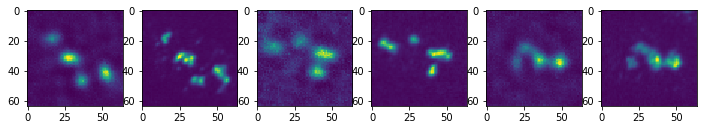

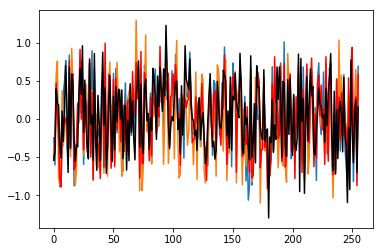

Epoch:  1 Iteration:  0 Loss:  2.43442


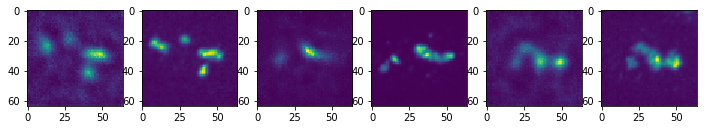

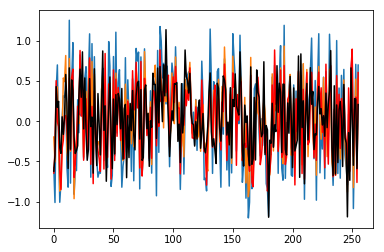

Epoch:  1 Iteration:  500 Loss:  2.16534


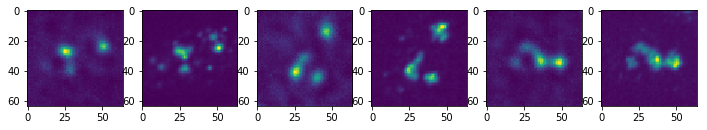

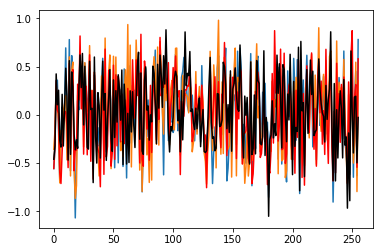

Epoch:  1 Iteration:  1000 Loss:  1.50187


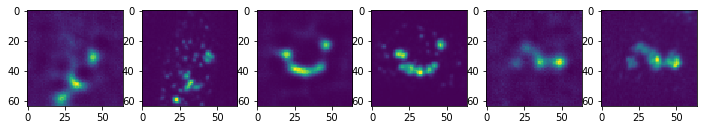

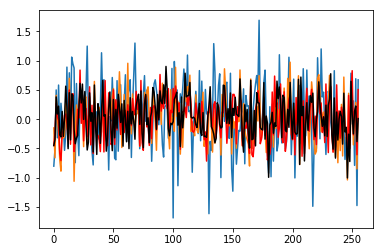

Epoch:  1 Iteration:  1500 Loss:  1.478


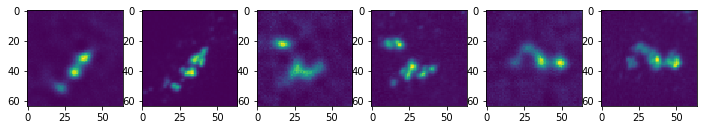

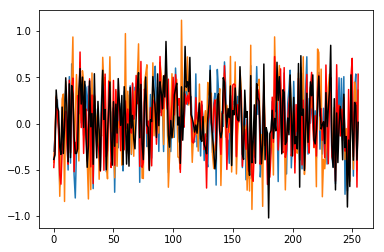

Epoch:  1 Iteration:  2000 Loss:  2.90303


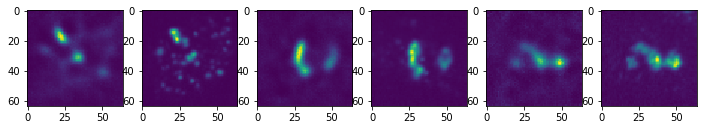

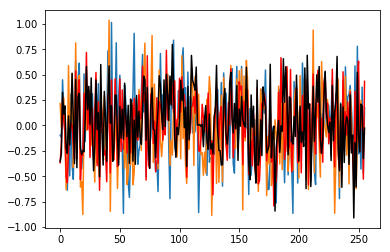

Epoch:  1 Iteration:  2500 Loss:  1.43399


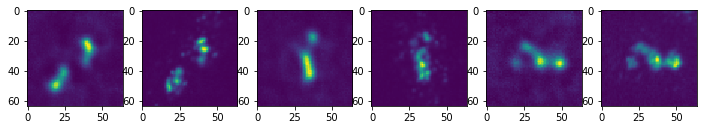

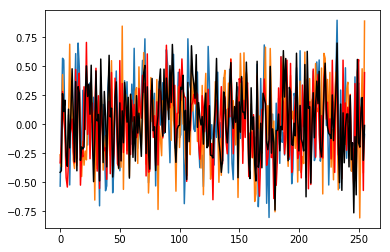

Epoch:  1 Iteration:  3000 Loss:  1.70563


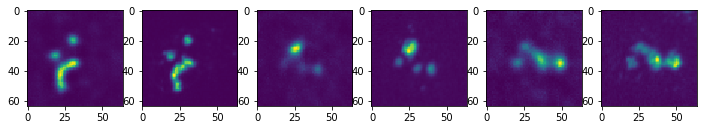

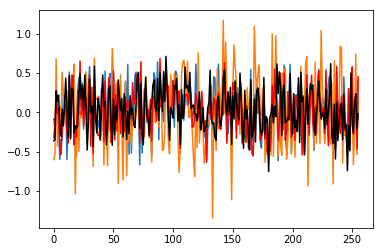

Epoch:  1 Iteration:  3500 Loss:  1.39578


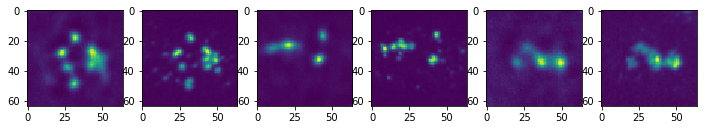

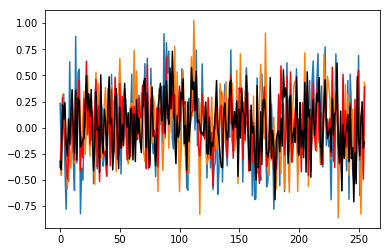

Epoch:  1 Iteration:  4000 Loss:  1.50764


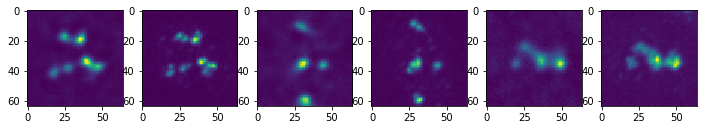

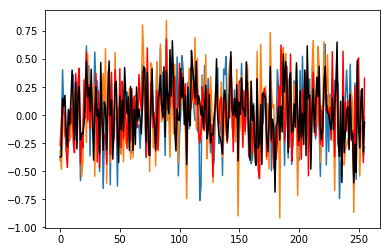

Epoch:  1 Iteration:  4500 Loss:  1.85026


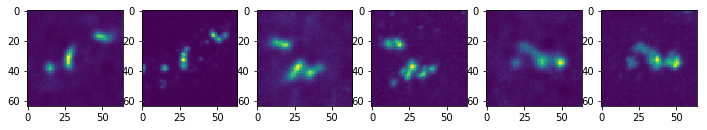

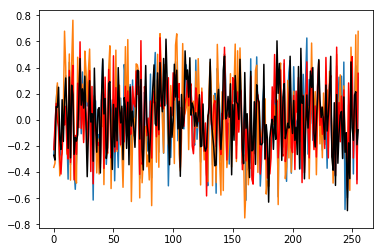

Epoch:  1 Iteration:  5000 Loss:  1.429


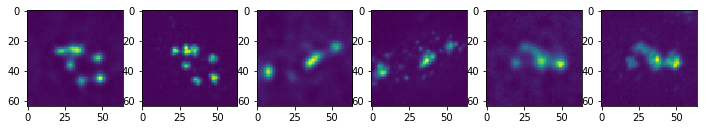

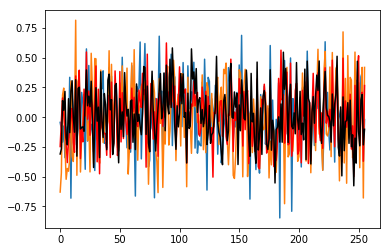

Epoch:  1 Iteration:  5500 Loss:  1.2026


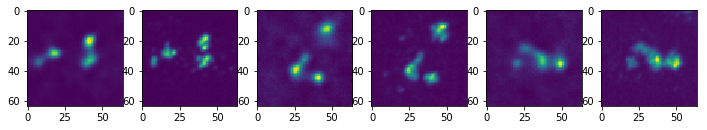

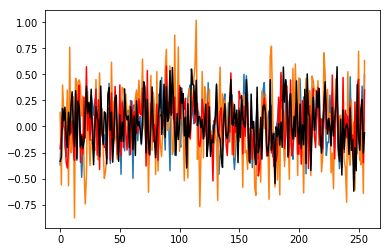

Epoch:  2 Iteration:  0 Loss:  1.32177


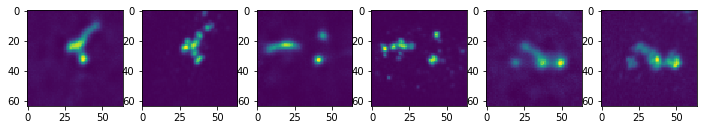

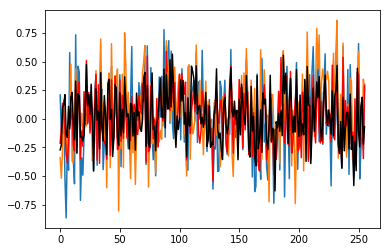

Epoch:  2 Iteration:  500 Loss:  1.25825


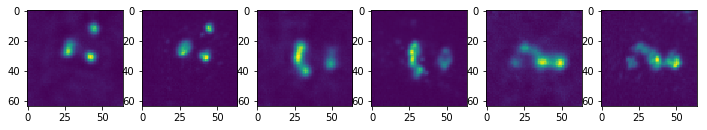

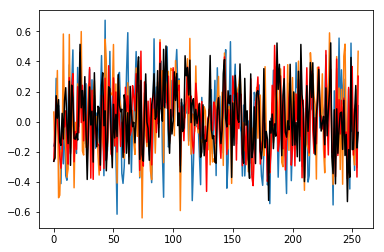

Epoch:  2 Iteration:  1000 Loss:  0.967805


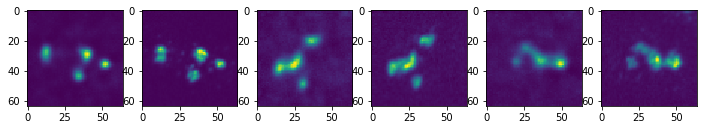

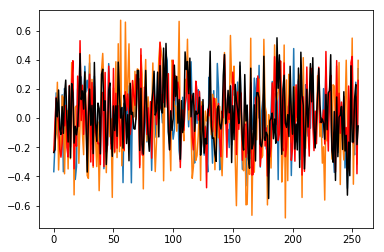

Epoch:  2 Iteration:  1500 Loss:  0.83983


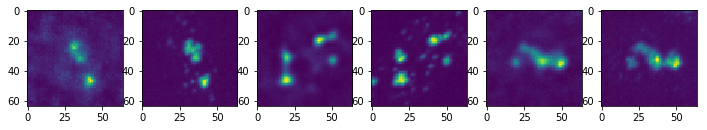

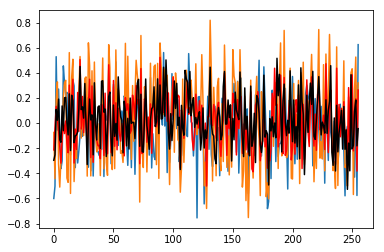

Epoch:  2 Iteration:  2000 Loss:  1.82567


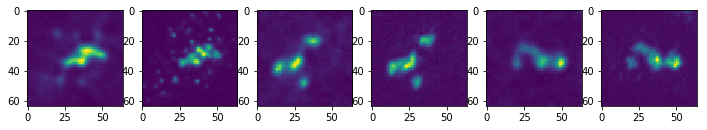

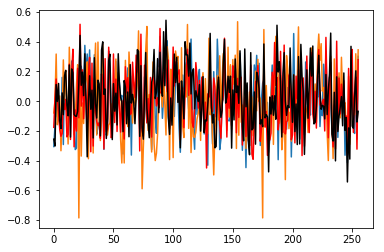

Epoch:  2 Iteration:  2500 Loss:  0.983168


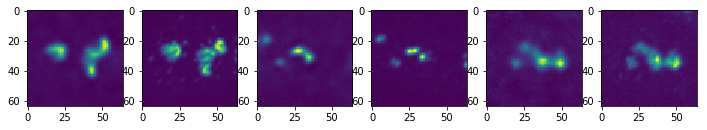

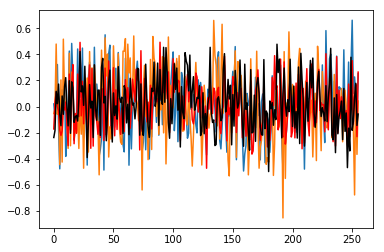

Epoch:  2 Iteration:  3000 Loss:  1.30077


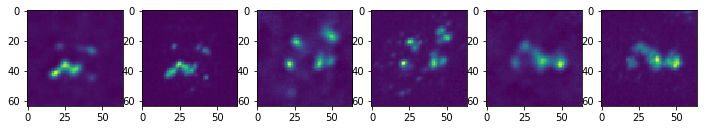

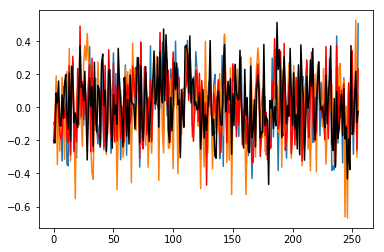

Epoch:  2 Iteration:  3500 Loss:  0.969471


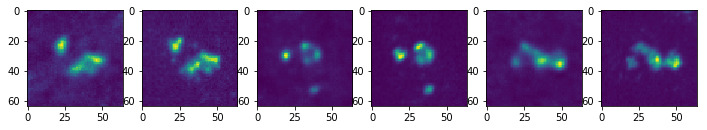

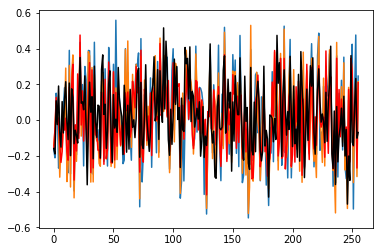

Epoch:  2 Iteration:  4000 Loss:  0.98284


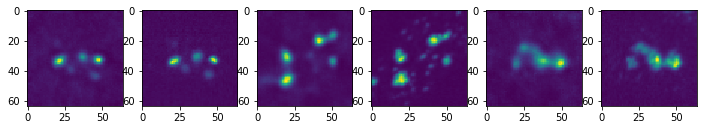

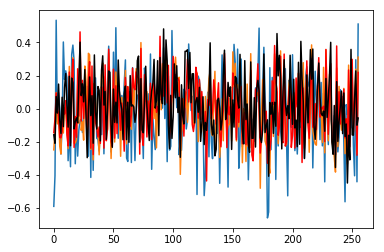

Epoch:  2 Iteration:  4500 Loss:  1.28184


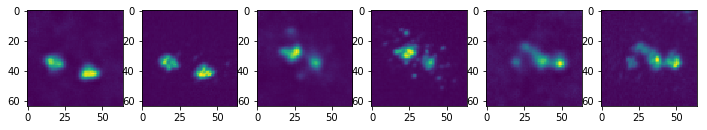

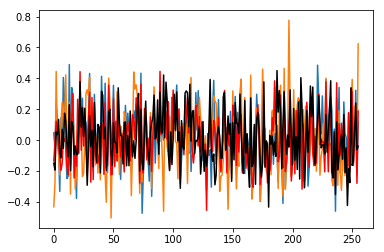

Epoch:  2 Iteration:  5000 Loss:  0.95204


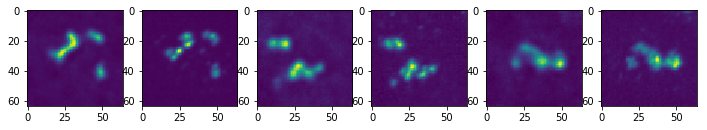

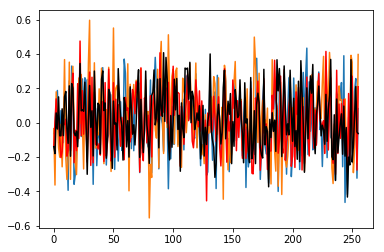

Epoch:  2 Iteration:  5500 Loss:  0.925637


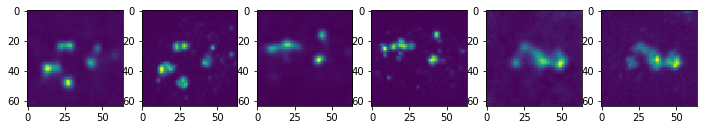

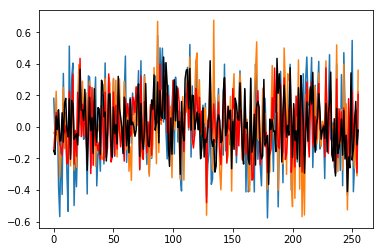

Epoch:  3 Iteration:  0 Loss:  0.883789


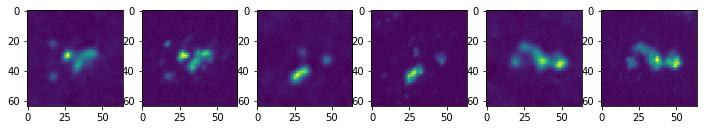

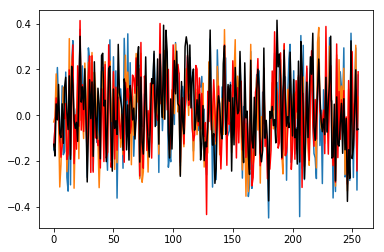

Epoch:  3 Iteration:  500 Loss:  0.967829


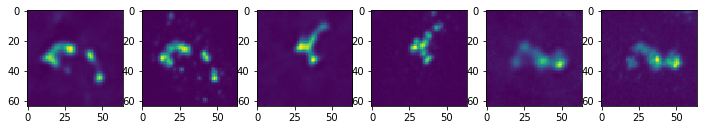

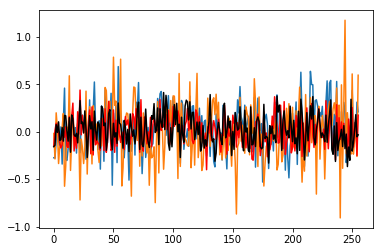

Epoch:  3 Iteration:  1000 Loss:  0.720953


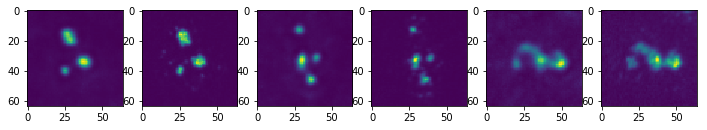

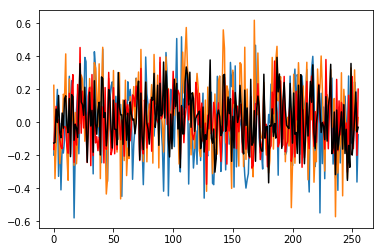

Epoch:  3 Iteration:  1500 Loss:  0.652481


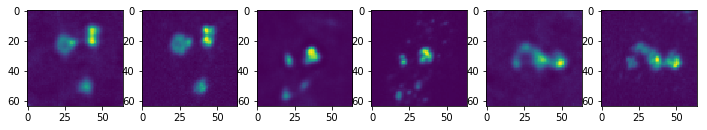

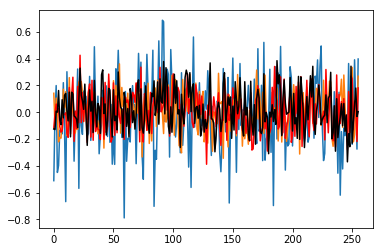

Epoch:  3 Iteration:  2000 Loss:  1.36008


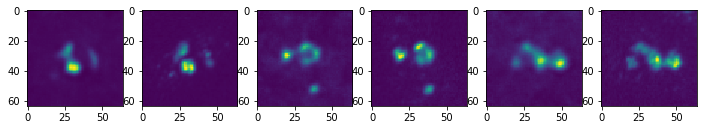

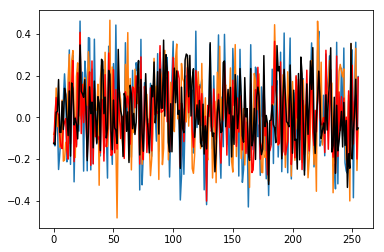

Epoch:  3 Iteration:  2500 Loss:  0.757863


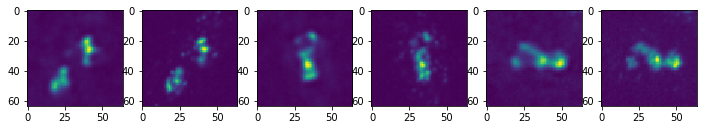

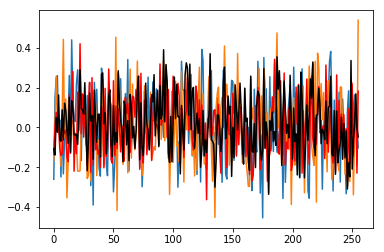

Epoch:  3 Iteration:  3000 Loss:  0.882065


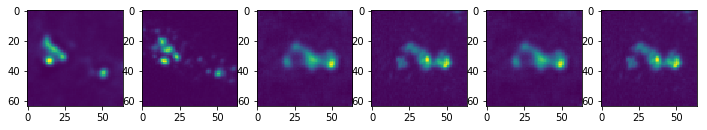

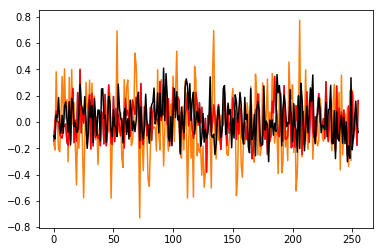

Epoch:  3 Iteration:  3500 Loss:  0.768532


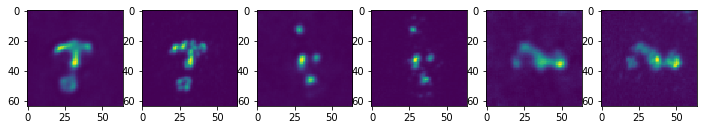

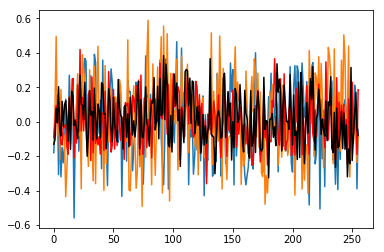

Epoch:  3 Iteration:  4000 Loss:  0.751018


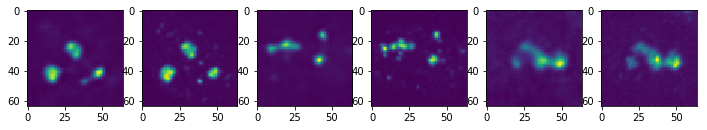

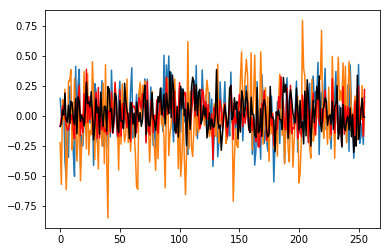

Epoch:  3 Iteration:  4500 Loss:  1.03512


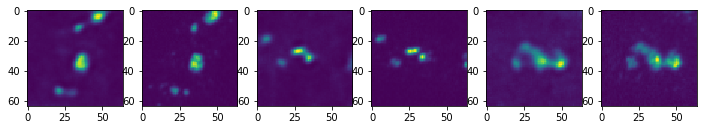

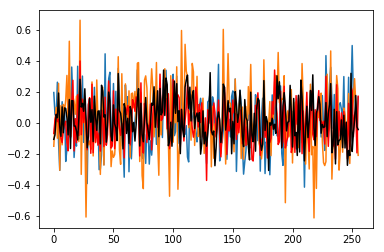

Epoch:  3 Iteration:  5000 Loss:  0.765861


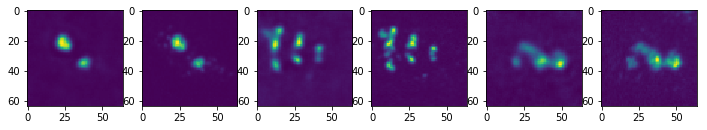

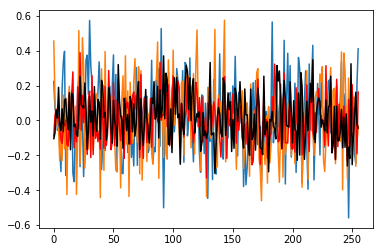

Epoch:  3 Iteration:  5500 Loss:  0.731567


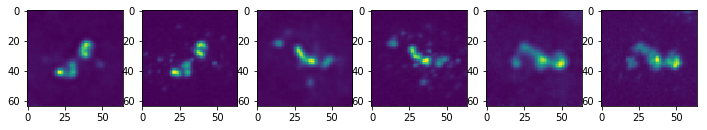

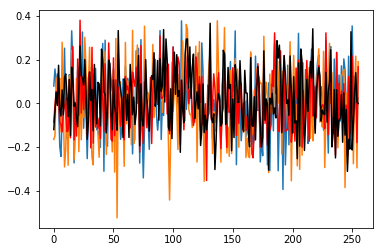

Epoch:  4 Iteration:  0 Loss:  0.750565


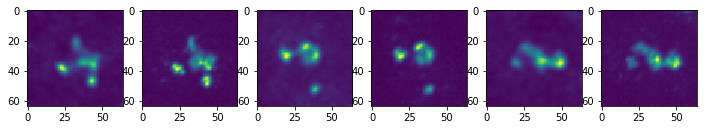

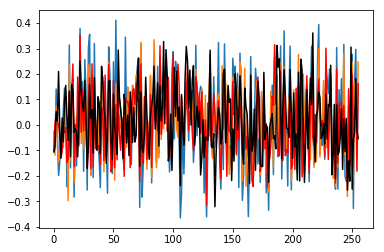

Epoch:  4 Iteration:  500 Loss:  0.787102


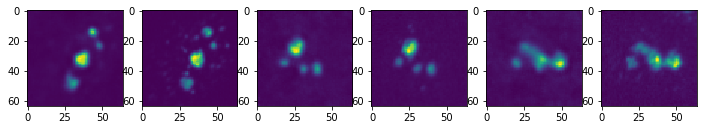

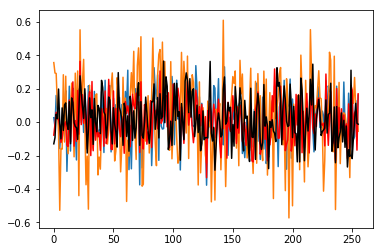

Epoch:  4 Iteration:  1000 Loss:  0.604755


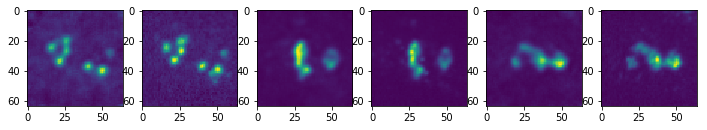

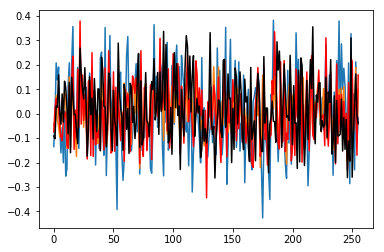

Epoch:  4 Iteration:  1500 Loss:  0.498505


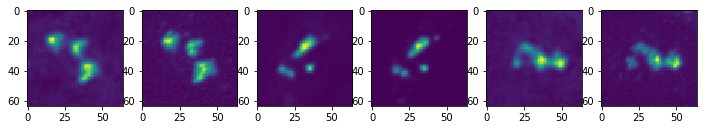

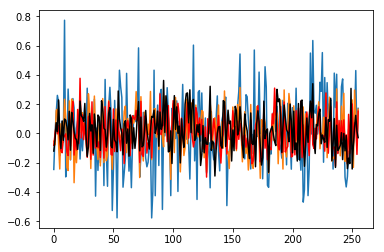

Epoch:  4 Iteration:  2000 Loss:  1.18177


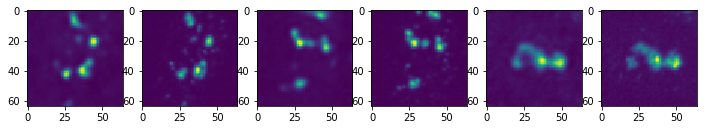

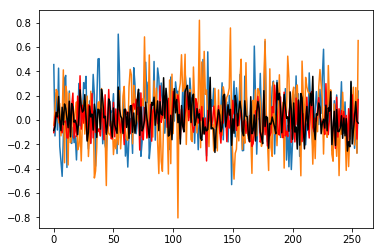

Epoch:  4 Iteration:  2500 Loss:  0.621955


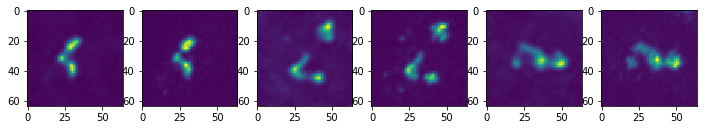

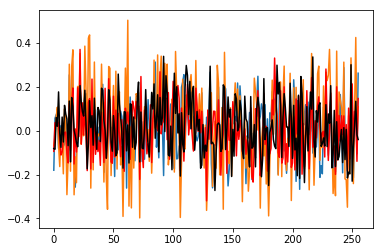

Epoch:  4 Iteration:  3000 Loss:  0.82742


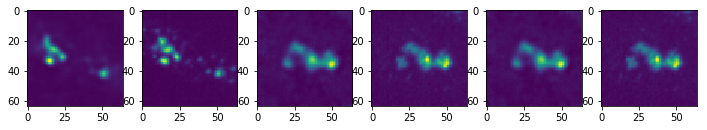

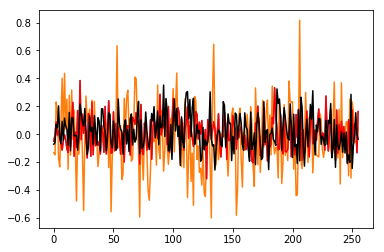

Epoch:  4 Iteration:  3500 Loss:  0.647702


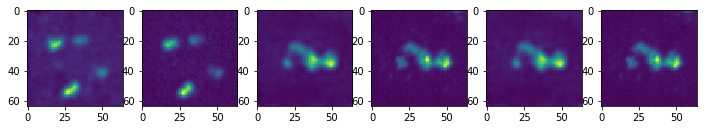

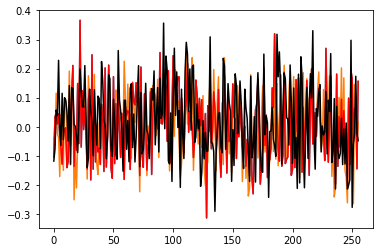

Epoch:  4 Iteration:  4000 Loss:  0.63021


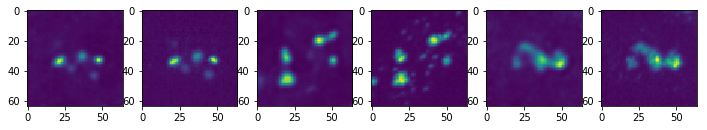

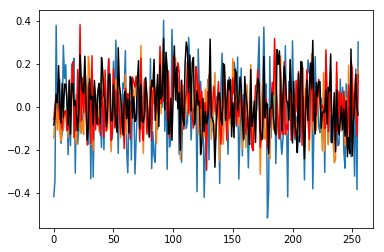

Epoch:  4 Iteration:  4500 Loss:  0.867755


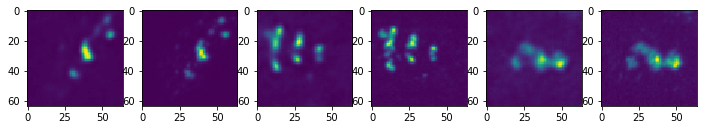

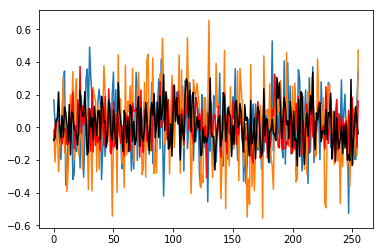

Epoch:  4 Iteration:  5000 Loss:  0.640301


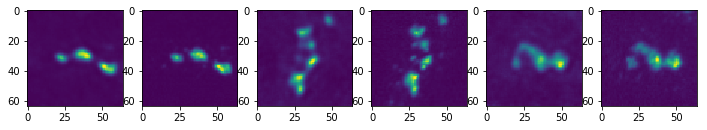

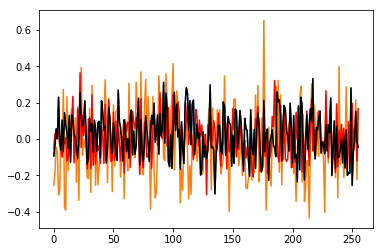

Epoch:  4 Iteration:  5500 Loss:  0.605109


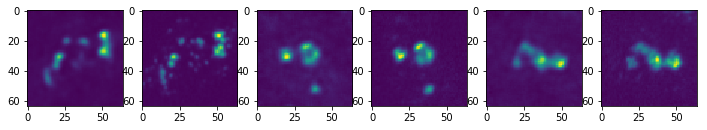

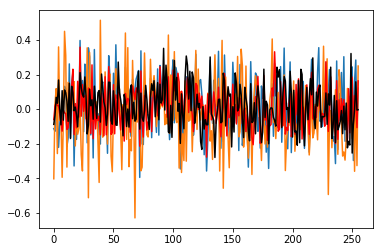

Epoch:  5 Iteration:  0 Loss:  0.647677


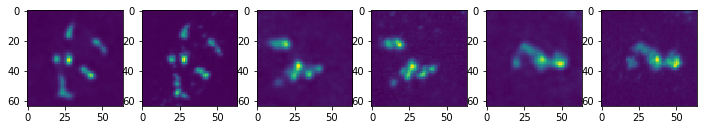

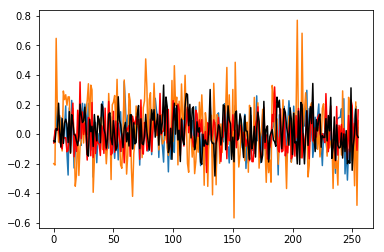

Epoch:  5 Iteration:  500 Loss:  0.671067


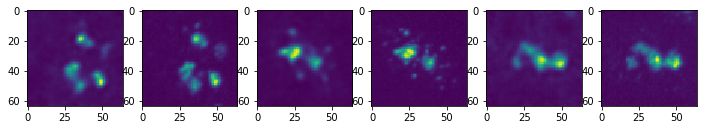

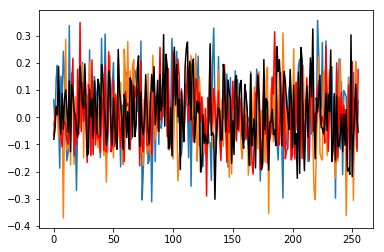

Epoch:  5 Iteration:  1000 Loss:  0.49506


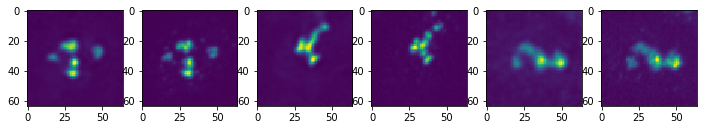

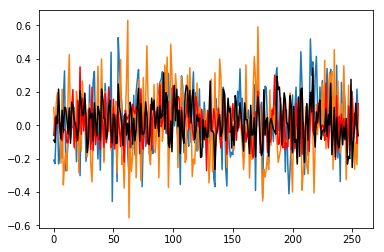

Epoch:  5 Iteration:  1500 Loss:  0.432278


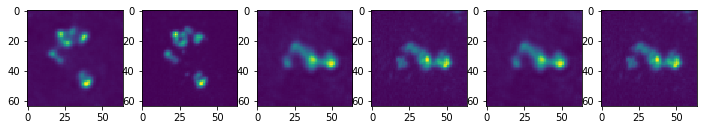

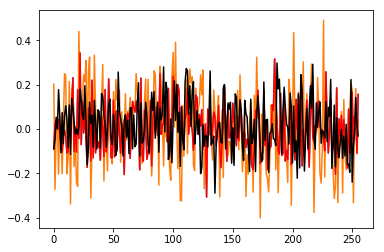

Epoch:  5 Iteration:  2000 Loss:  0.981524


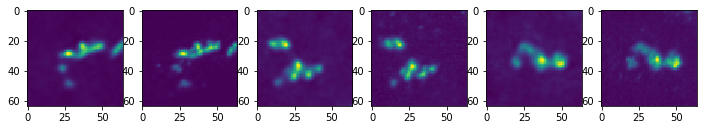

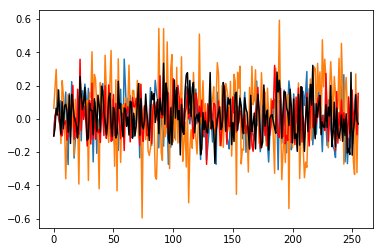

Epoch:  5 Iteration:  2500 Loss:  0.556091


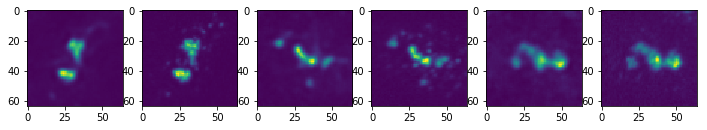

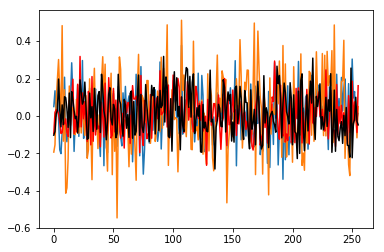

Epoch:  5 Iteration:  3000 Loss:  0.596171


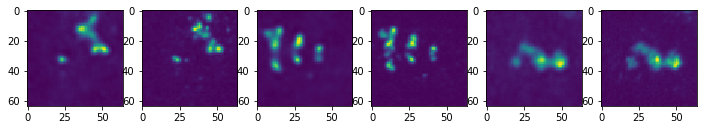

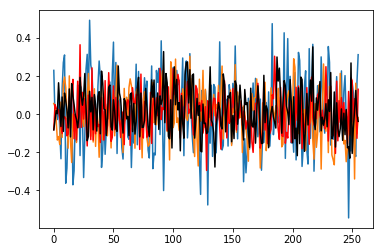

Epoch:  5 Iteration:  3500 Loss:  0.567337


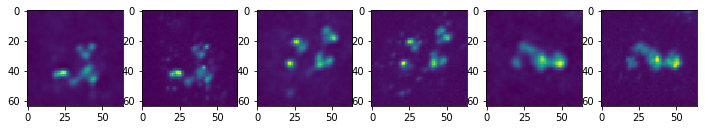

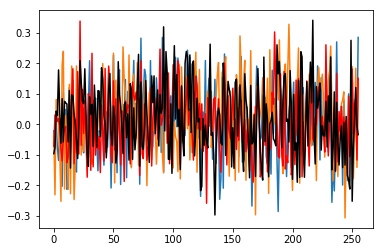

Epoch:  5 Iteration:  4000 Loss:  0.547361


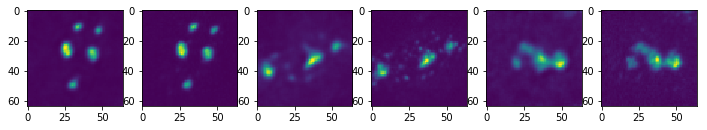

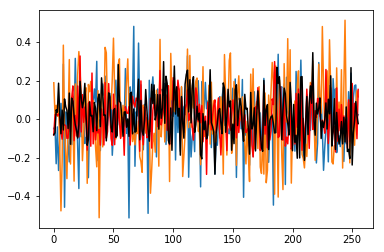

Epoch:  5 Iteration:  4500 Loss:  0.754218


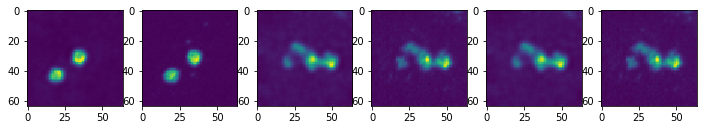

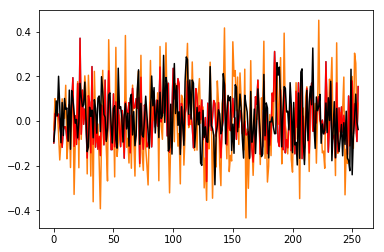

Epoch:  5 Iteration:  5000 Loss:  0.574812


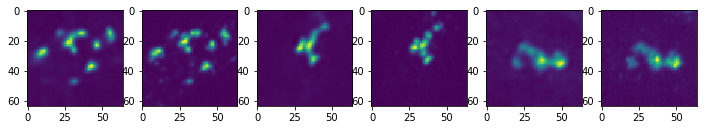

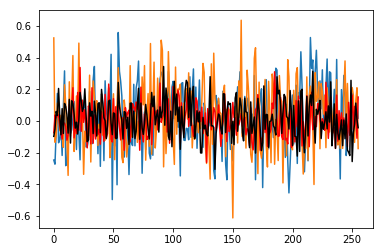

Epoch:  5 Iteration:  5500 Loss:  0.514466


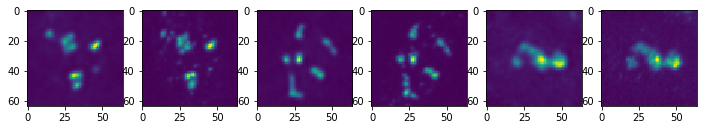

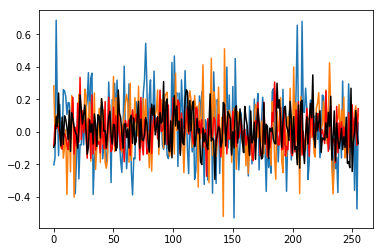

Epoch:  6 Iteration:  0 Loss:  0.547822


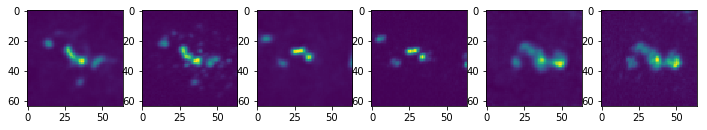

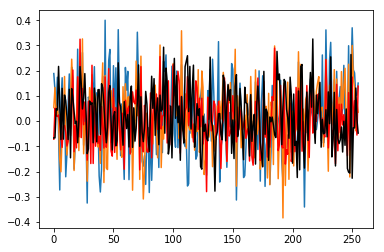

Epoch:  6 Iteration:  500 Loss:  0.609839


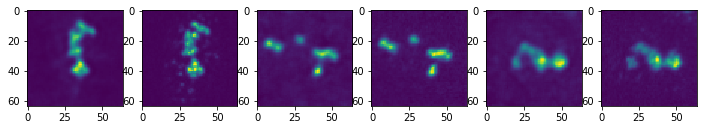

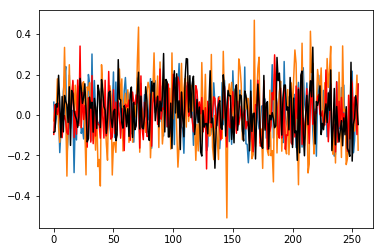

Epoch:  6 Iteration:  1000 Loss:  0.448857


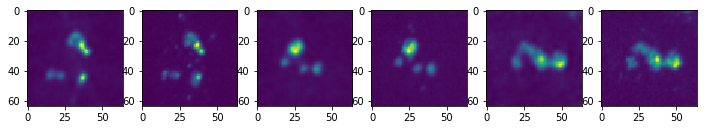

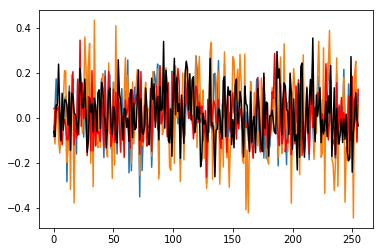

Epoch:  6 Iteration:  1500 Loss:  0.385496


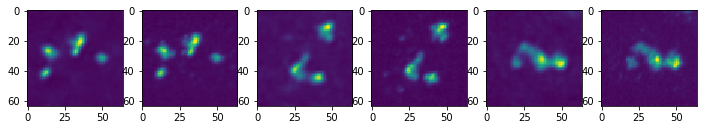

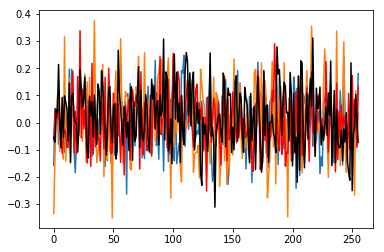

Epoch:  6 Iteration:  2000 Loss:  0.880497


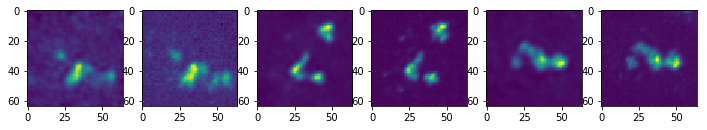

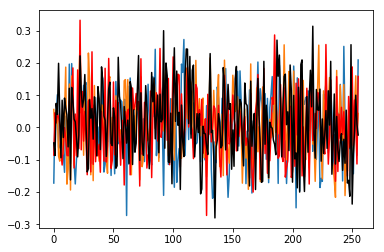

Epoch:  6 Iteration:  2500 Loss:  0.503297


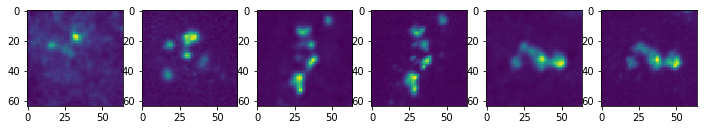

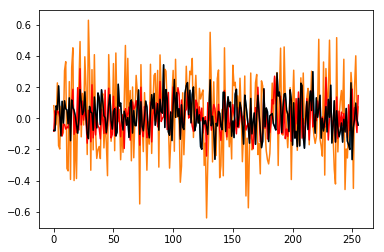

Epoch:  6 Iteration:  3000 Loss:  0.539098


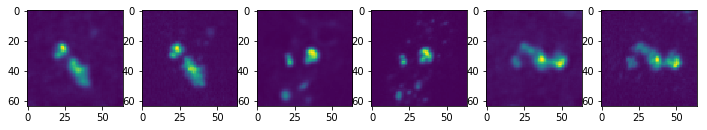

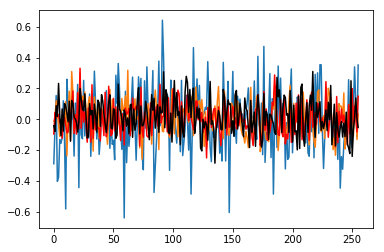

Epoch:  6 Iteration:  3500 Loss:  0.514934


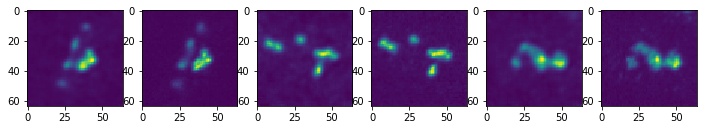

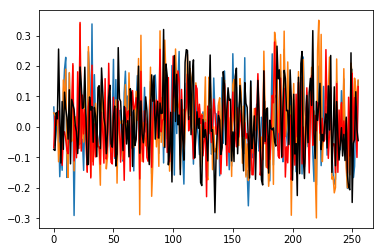

Epoch:  6 Iteration:  4000 Loss:  0.478778


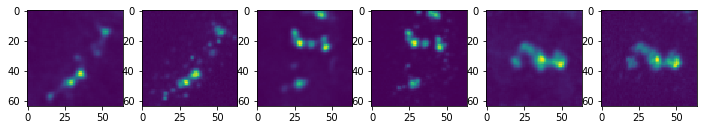

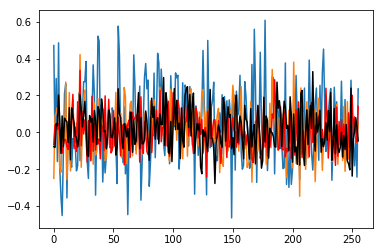

Epoch:  6 Iteration:  4500 Loss:  0.690253


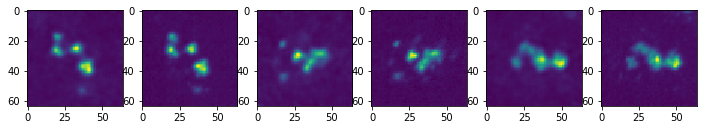

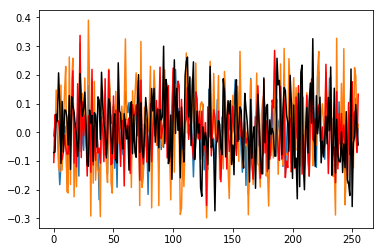

Epoch:  6 Iteration:  5000 Loss:  0.501865


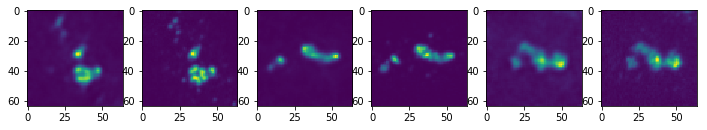

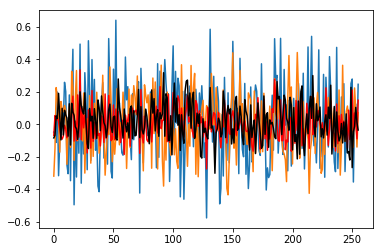

Epoch:  6 Iteration:  5500 Loss:  0.471996


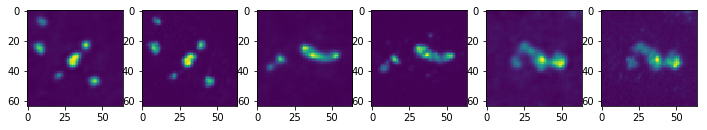

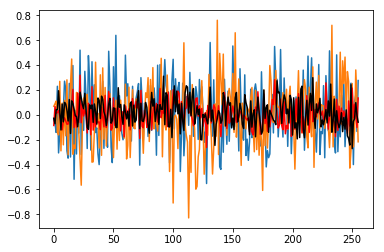

Epoch:  7 Iteration:  0 Loss:  0.510372


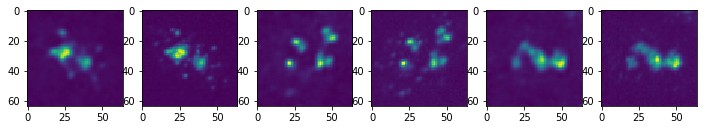

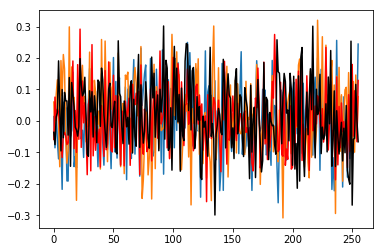

Epoch:  7 Iteration:  500 Loss:  0.55669


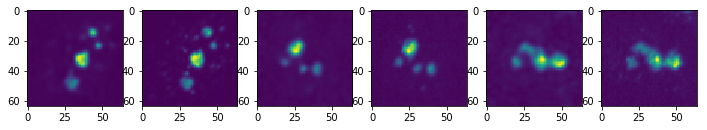

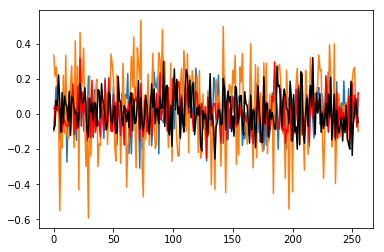

Epoch:  7 Iteration:  1000 Loss:  0.399918


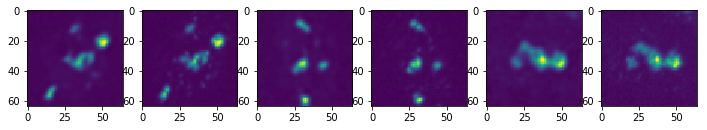

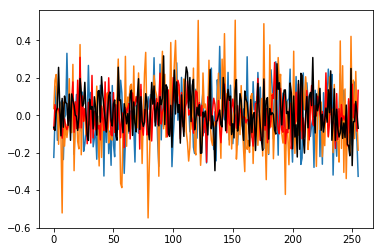

Epoch:  7 Iteration:  1500 Loss:  0.377768


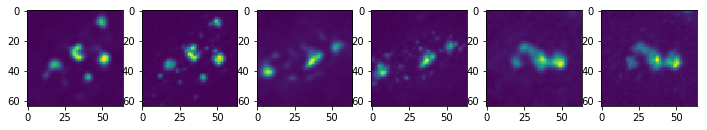

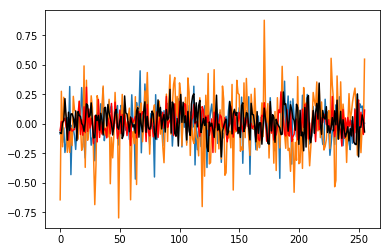

Epoch:  7 Iteration:  2000 Loss:  0.801927


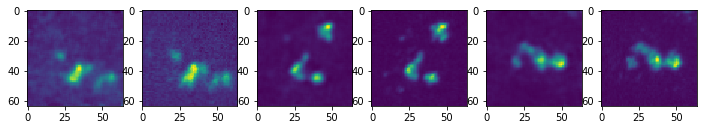

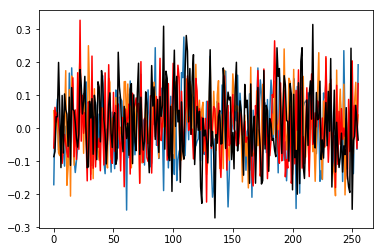

Epoch:  7 Iteration:  2500 Loss:  0.456781


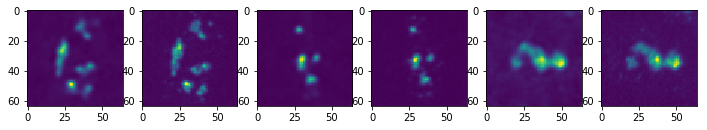

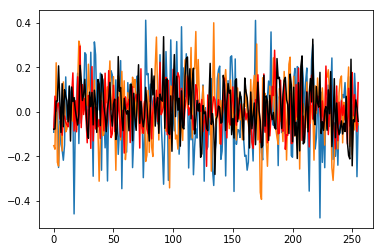

Epoch:  7 Iteration:  3000 Loss:  0.659555


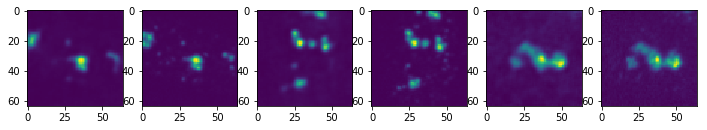

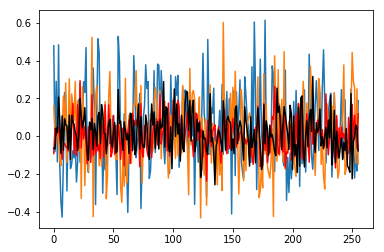

Epoch:  7 Iteration:  3500 Loss:  0.482752


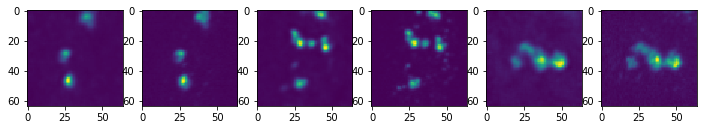

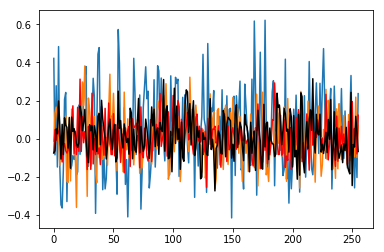

Epoch:  7 Iteration:  4000 Loss:  0.449468


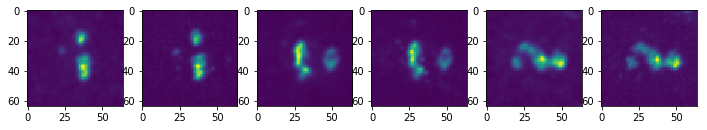

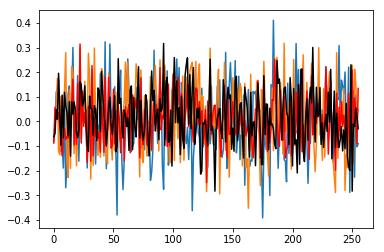

Epoch:  7 Iteration:  4500 Loss:  0.648025


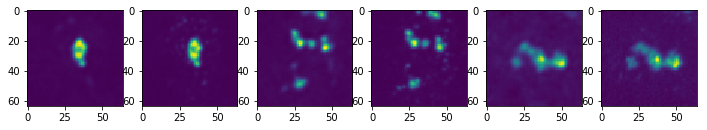

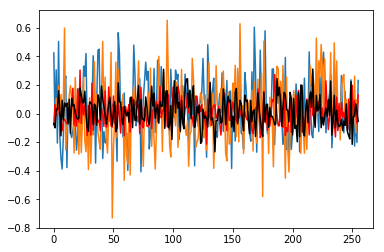

Epoch:  7 Iteration:  5000 Loss:  0.478586


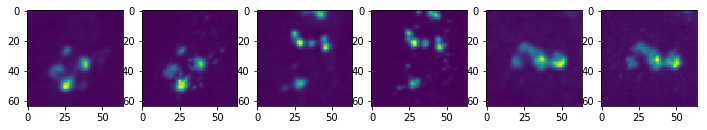

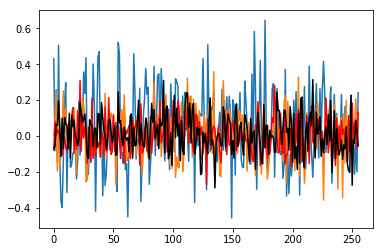

Epoch:  7 Iteration:  5500 Loss:  0.43451


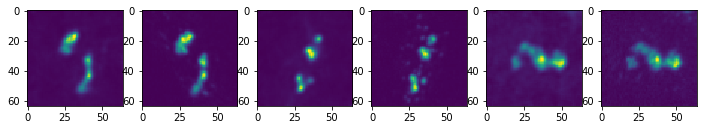

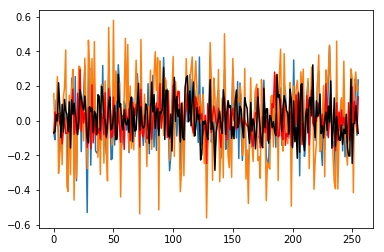

Epoch:  8 Iteration:  0 Loss:  0.495802


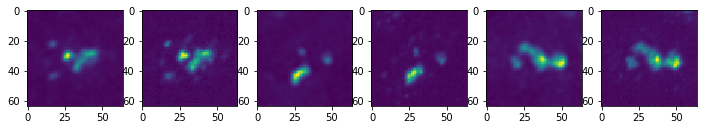

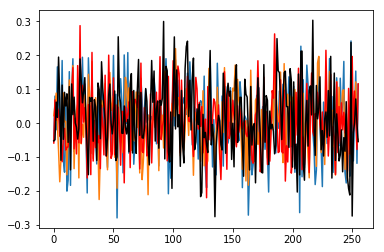

Epoch:  8 Iteration:  500 Loss:  0.502111


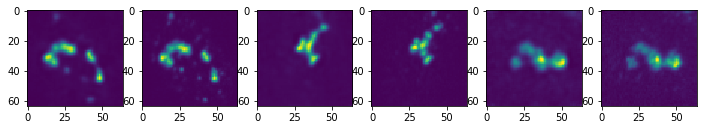

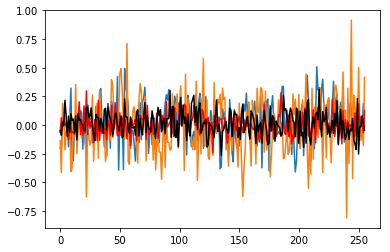

Epoch:  8 Iteration:  1000 Loss:  0.387047


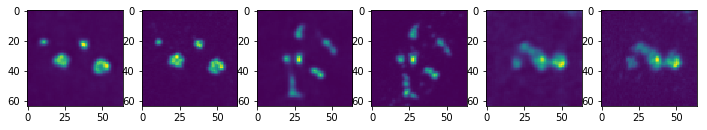

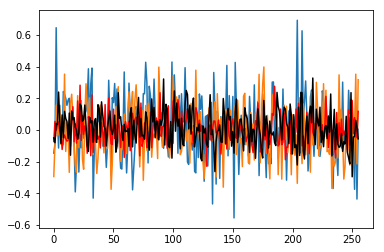

Epoch:  8 Iteration:  1500 Loss:  0.339678


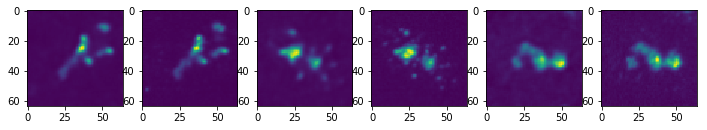

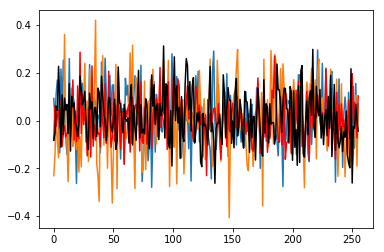

Epoch:  8 Iteration:  2000 Loss:  0.727493


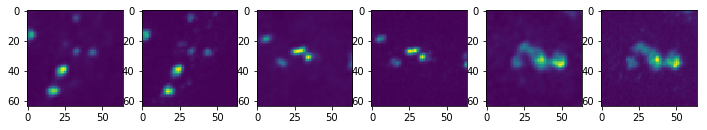

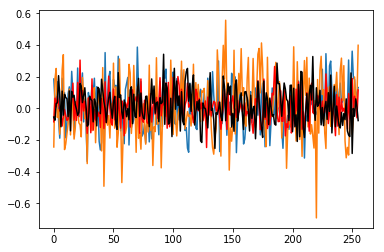

Epoch:  8 Iteration:  2500 Loss:  0.436528


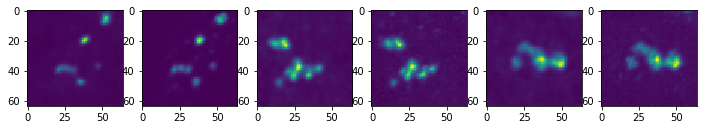

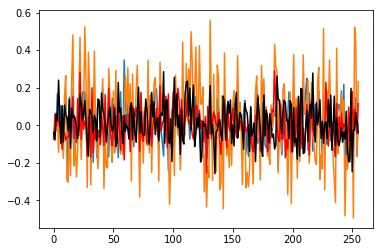

Epoch:  8 Iteration:  3000 Loss:  0.532523


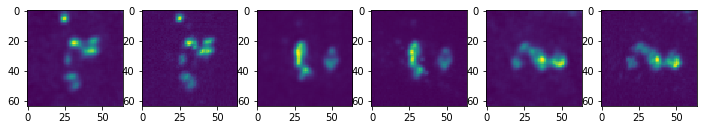

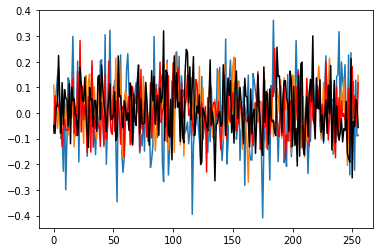

Epoch:  8 Iteration:  3500 Loss:  0.432357


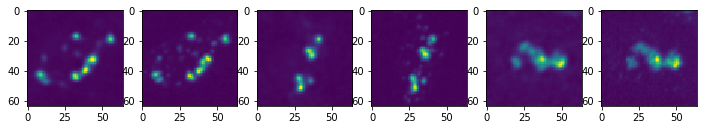

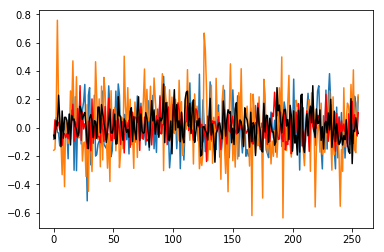

Epoch:  8 Iteration:  4000 Loss:  0.432223


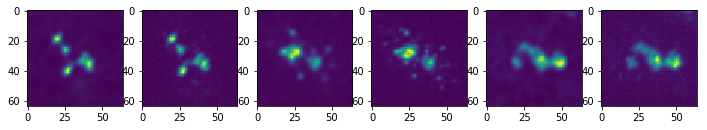

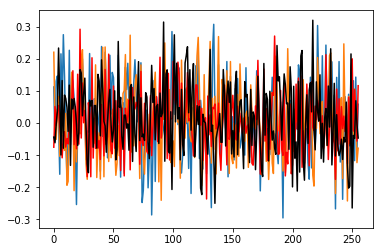

Epoch:  8 Iteration:  4500 Loss:  0.58538


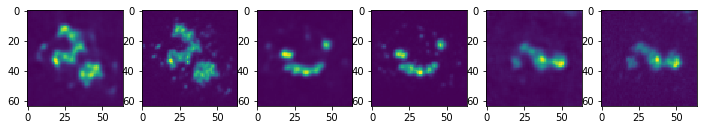

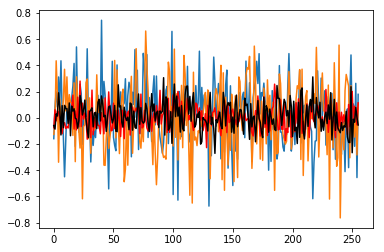

Epoch:  8 Iteration:  5000 Loss:  0.438968


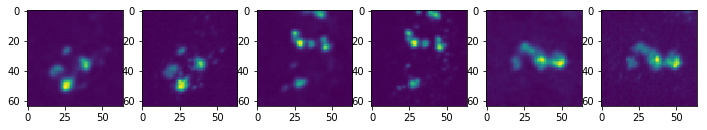

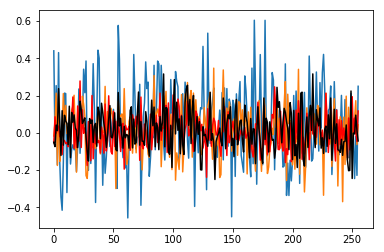

Epoch:  8 Iteration:  5500 Loss:  0.395512


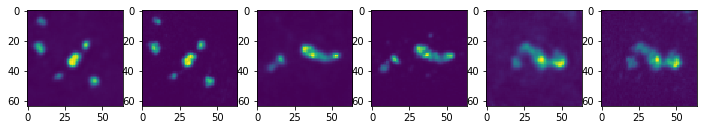

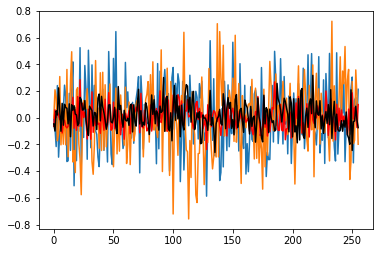

Epoch:  9 Iteration:  0 Loss:  0.420093


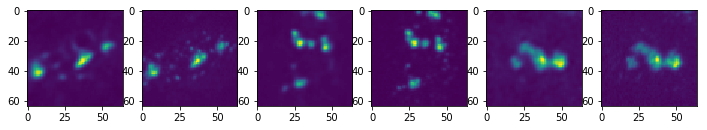

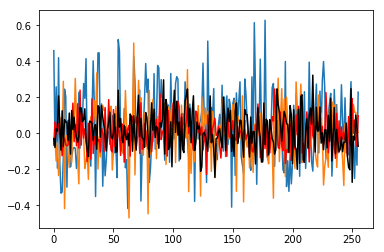

Epoch:  9 Iteration:  500 Loss:  0.485065


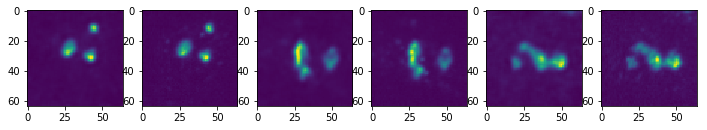

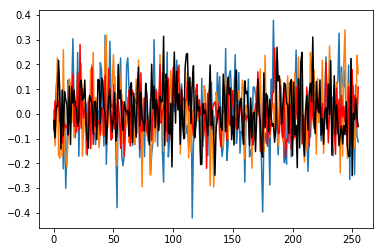

Epoch:  9 Iteration:  1000 Loss:  0.358168


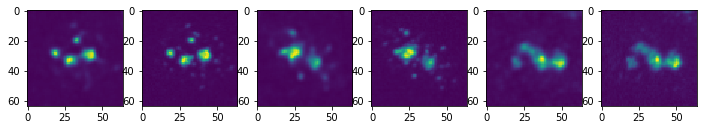

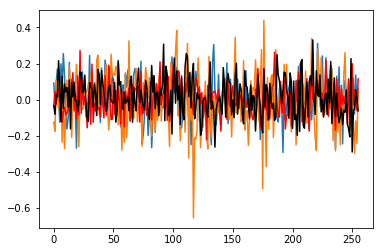

Epoch:  9 Iteration:  1500 Loss:  0.314588


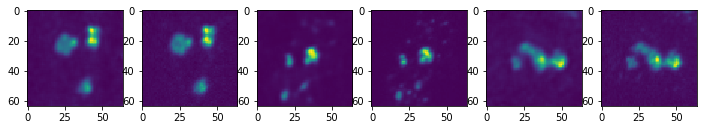

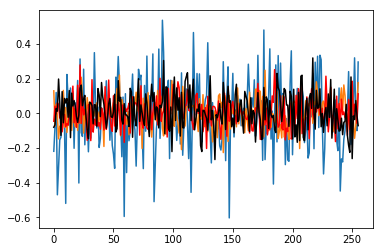

Epoch:  9 Iteration:  2000 Loss:  0.677888


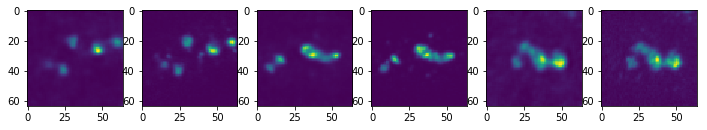

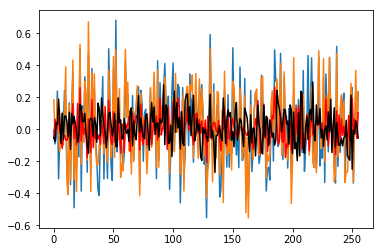

Epoch:  9 Iteration:  2500 Loss:  0.404189


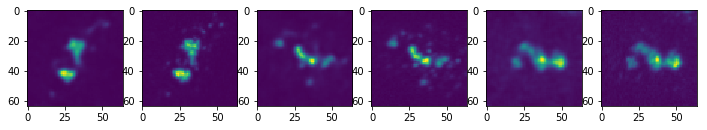

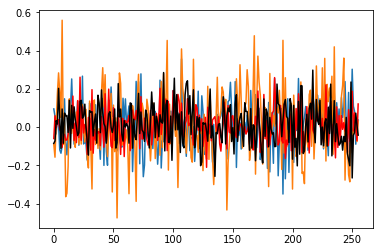

Epoch:  9 Iteration:  3000 Loss:  0.436618


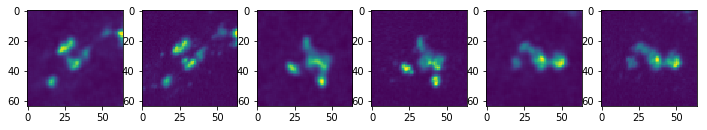

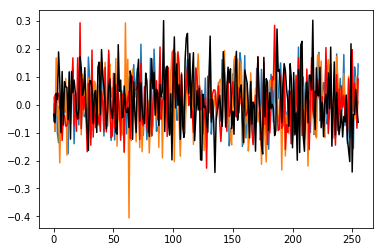

Epoch:  9 Iteration:  3500 Loss:  0.401209


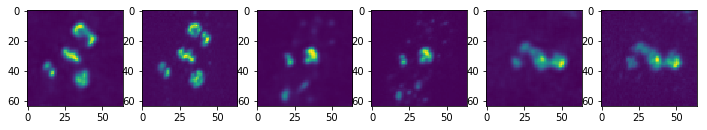

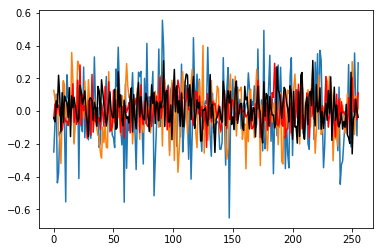

Epoch:  9 Iteration:  4000 Loss:  0.420304


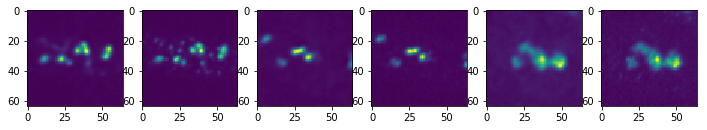

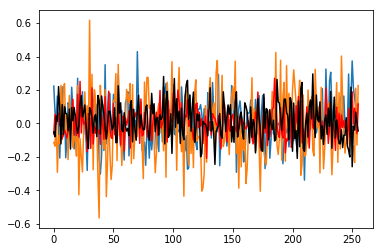

Epoch:  9 Iteration:  4500 Loss:  0.543702


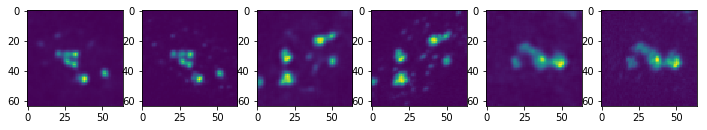

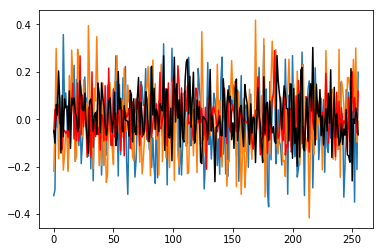

Epoch:  9 Iteration:  5000 Loss:  0.406777


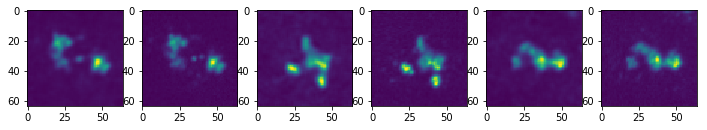

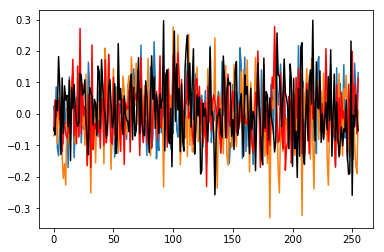

Epoch:  9 Iteration:  5500 Loss:  0.379187


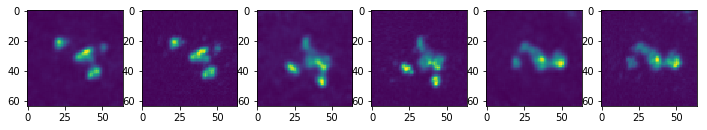

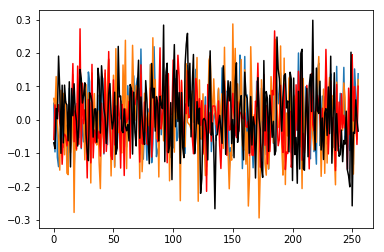

Epoch:  10 Iteration:  0 Loss:  0.401239


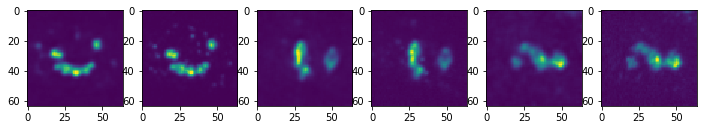

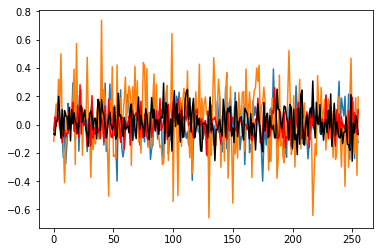

Epoch:  10 Iteration:  500 Loss:  0.461199


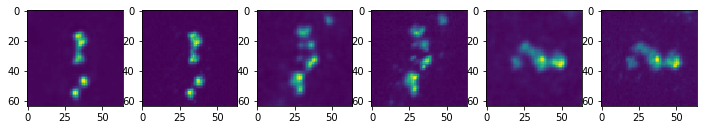

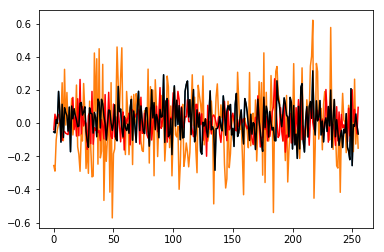

Epoch:  10 Iteration:  1000 Loss:  0.341157


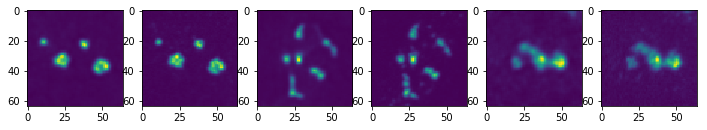

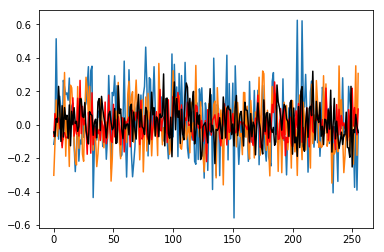

Epoch:  10 Iteration:  1500 Loss:  0.301189


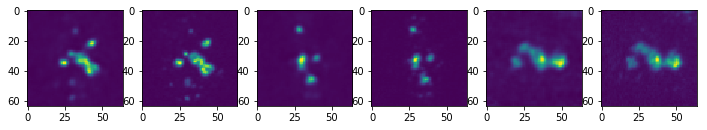

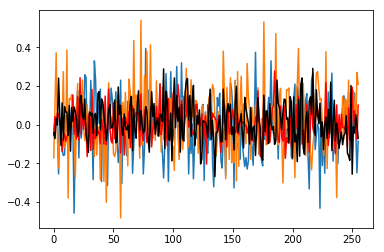

Epoch:  10 Iteration:  2000 Loss:  0.629244


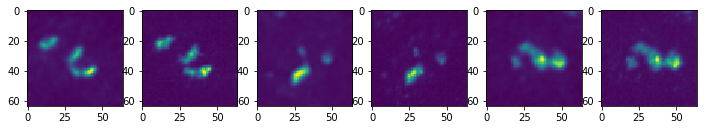

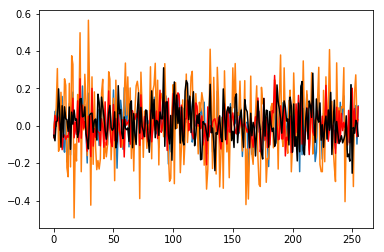

Epoch:  10 Iteration:  2500 Loss:  0.395342


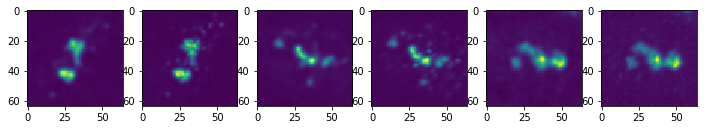

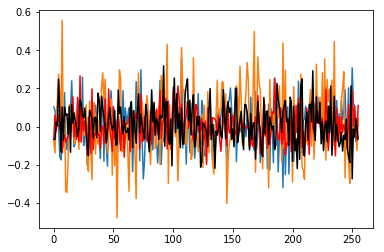

Epoch:  10 Iteration:  3000 Loss:  0.417314


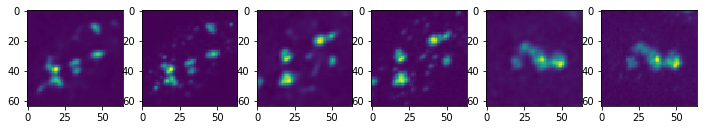

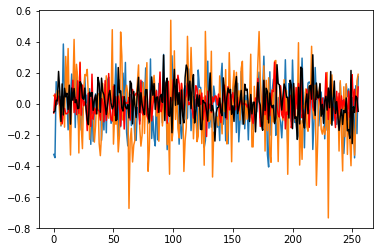

Epoch:  10 Iteration:  3500 Loss:  0.379503


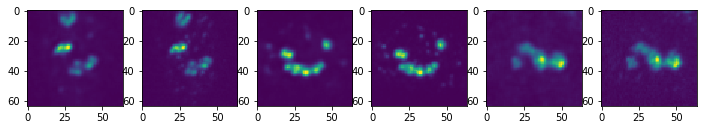

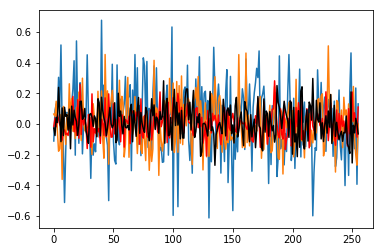

Epoch:  10 Iteration:  4000 Loss:  0.371201


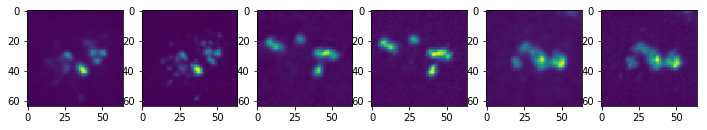

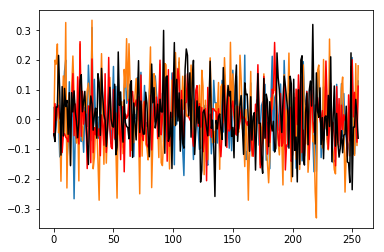

Epoch:  10 Iteration:  4500 Loss:  0.504102


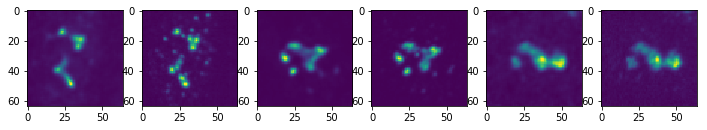

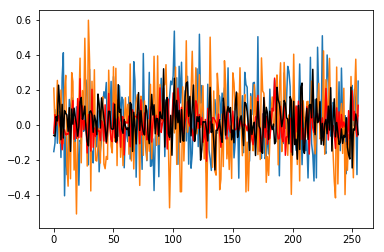

Epoch:  10 Iteration:  5000 Loss:  0.38199


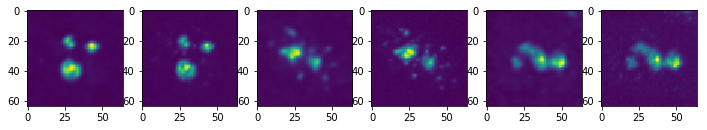

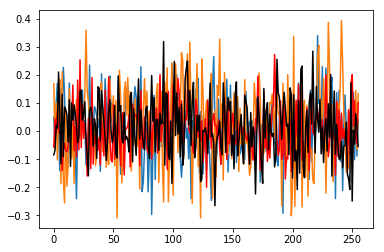

Epoch:  10 Iteration:  5500 Loss:  0.348456


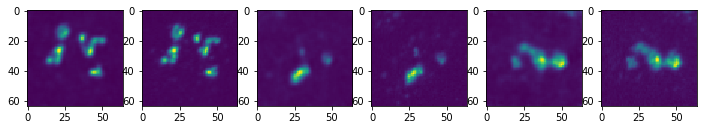

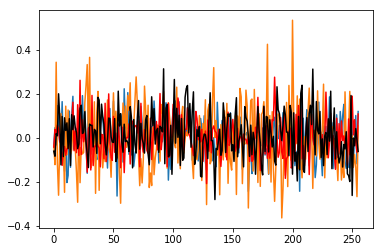

Epoch:  11 Iteration:  0 Loss:  0.392344


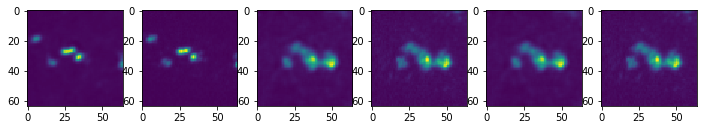

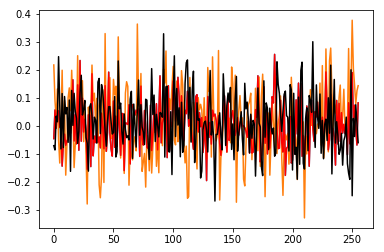

Epoch:  11 Iteration:  500 Loss:  0.436988


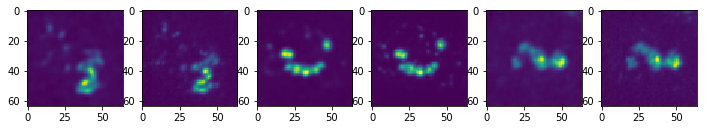

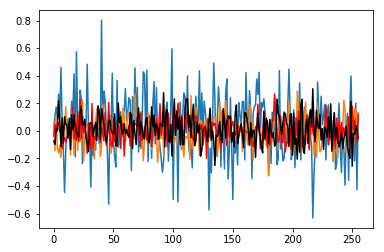

Epoch:  11 Iteration:  1000 Loss:  0.314861


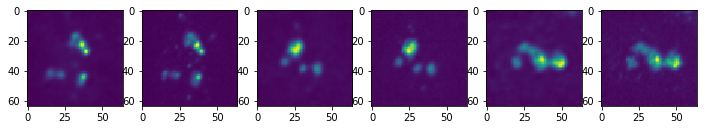

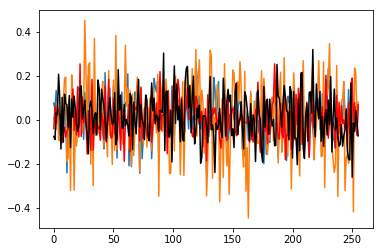

Epoch:  11 Iteration:  1500 Loss:  0.27961


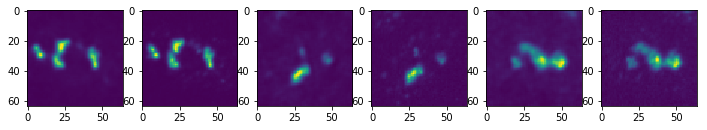

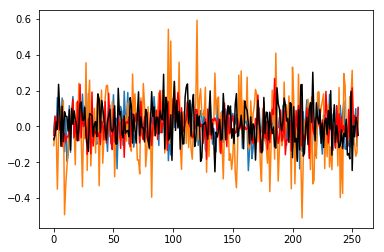

Epoch:  11 Iteration:  2000 Loss:  0.60263


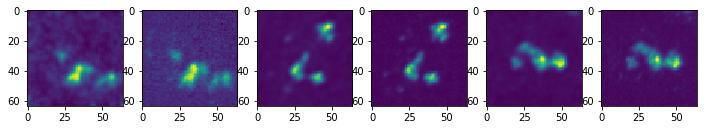

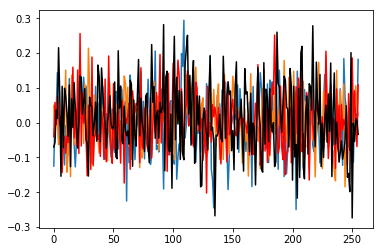

Epoch:  11 Iteration:  2500 Loss:  0.370229


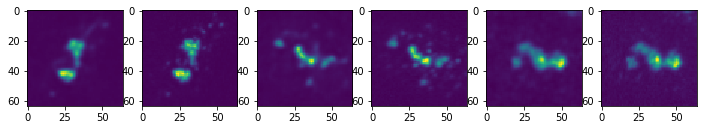

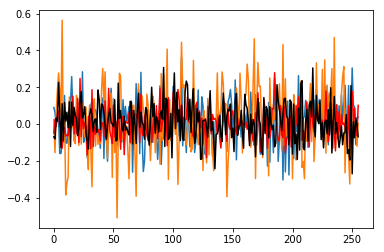

Epoch:  11 Iteration:  3000 Loss:  0.377168


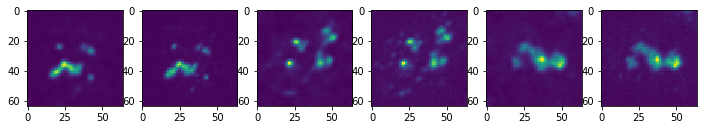

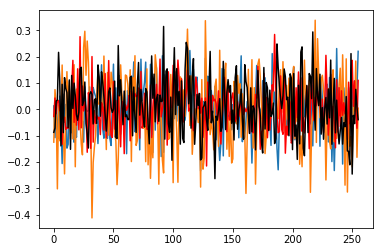

Epoch:  11 Iteration:  3500 Loss:  0.364479


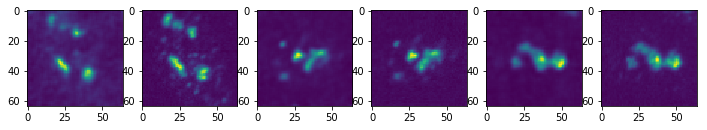

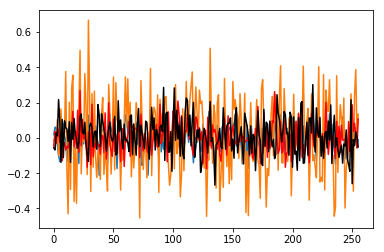

Epoch:  11 Iteration:  4000 Loss:  0.353461


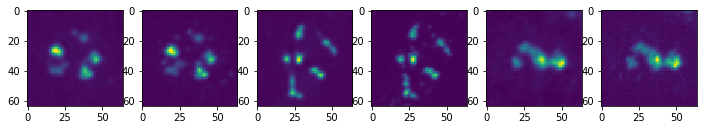

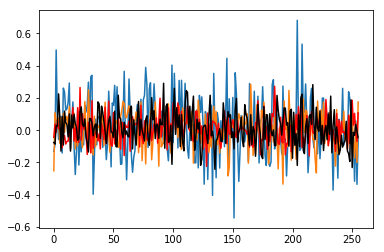

Epoch:  11 Iteration:  4500 Loss:  0.490321


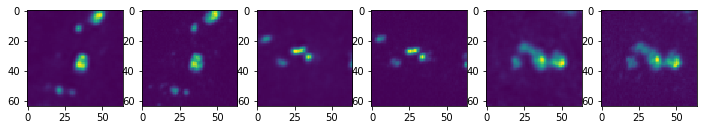

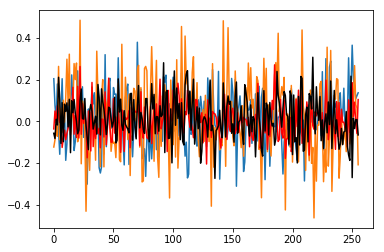

Epoch:  11 Iteration:  5000 Loss:  0.364147


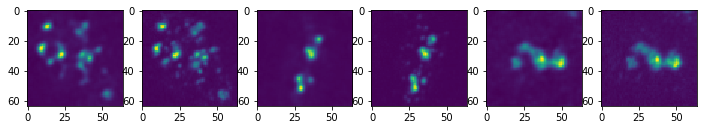

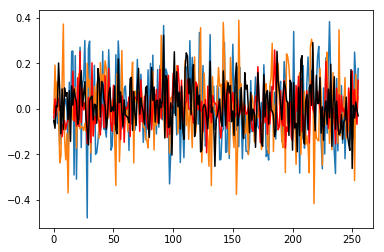

Epoch:  11 Iteration:  5500 Loss:  0.325322


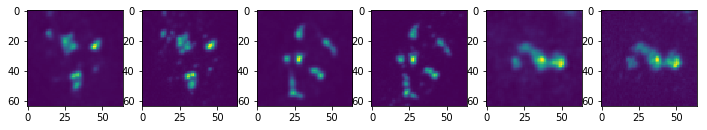

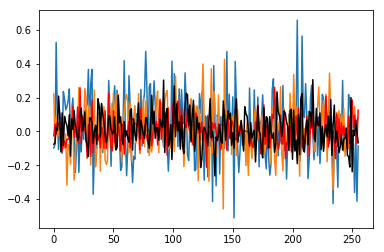

Epoch:  12 Iteration:  0 Loss:  0.365861


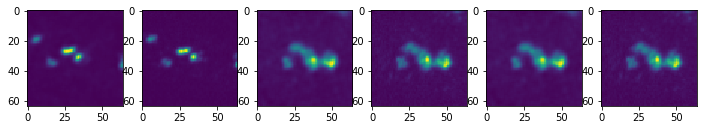

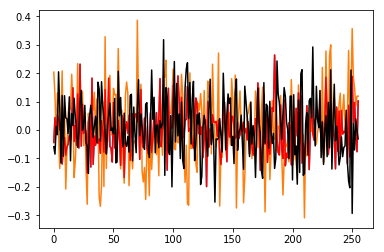

Epoch:  12 Iteration:  500 Loss:  0.40451


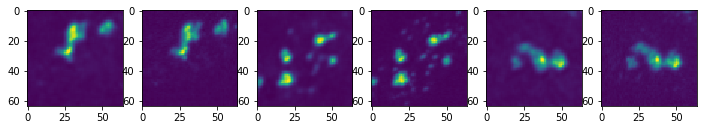

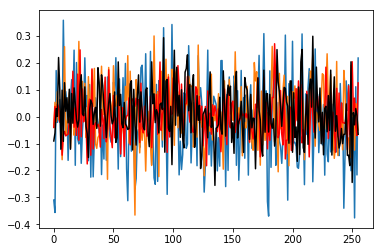

Epoch:  12 Iteration:  1000 Loss:  0.316774


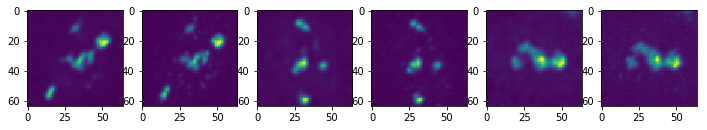

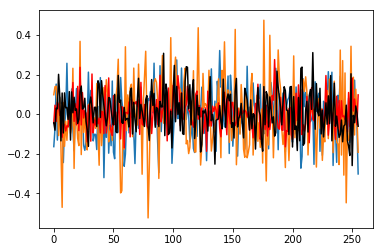

Epoch:  12 Iteration:  1500 Loss:  0.267173


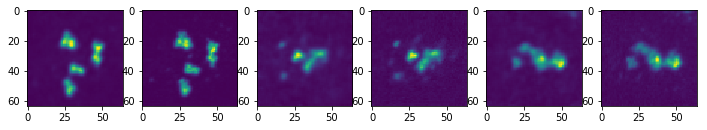

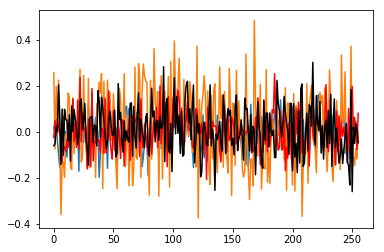

Epoch:  12 Iteration:  2000 Loss:  0.598864


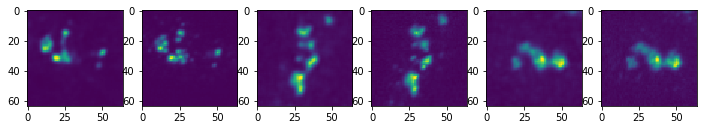

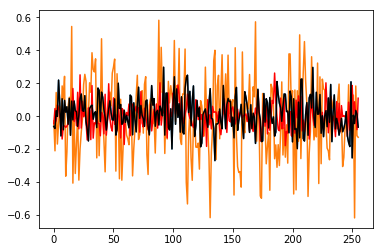

Epoch:  12 Iteration:  2500 Loss:  0.349006


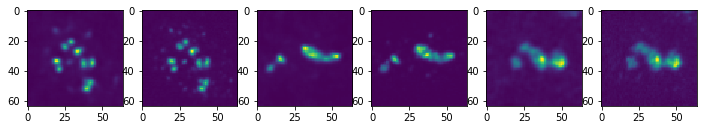

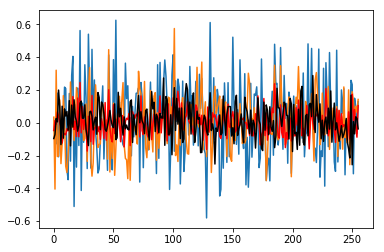

Epoch:  12 Iteration:  3000 Loss:  0.372557


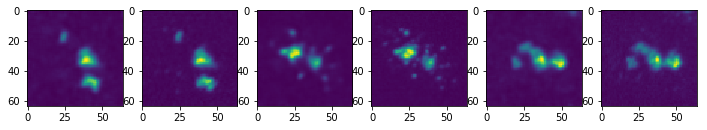

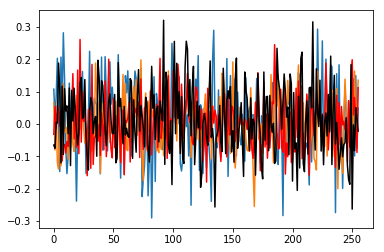

Epoch:  12 Iteration:  3500 Loss:  0.344726


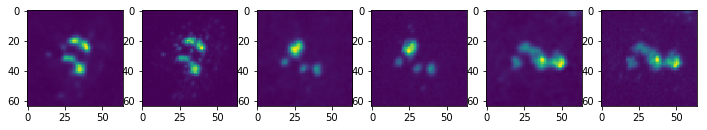

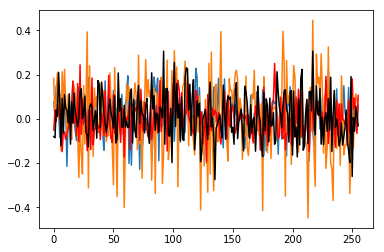

Epoch:  12 Iteration:  4000 Loss:  0.347648


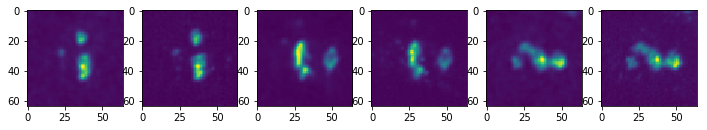

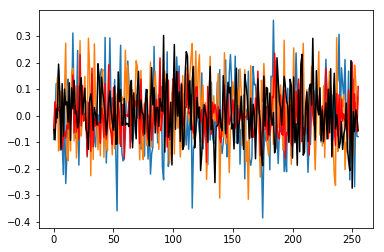

Epoch:  12 Iteration:  4500 Loss:  0.469833


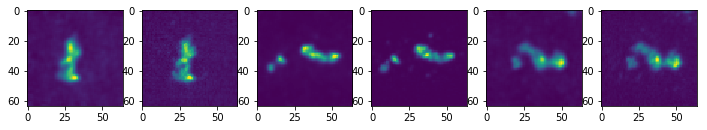

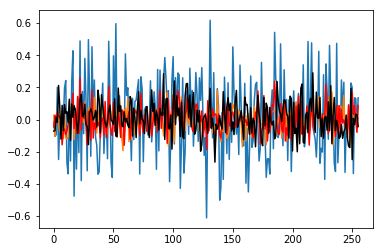

Epoch:  12 Iteration:  5000 Loss:  0.367763


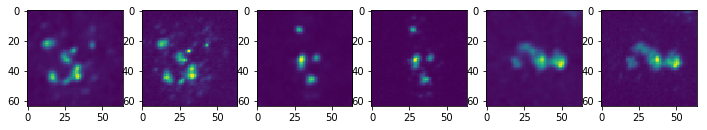

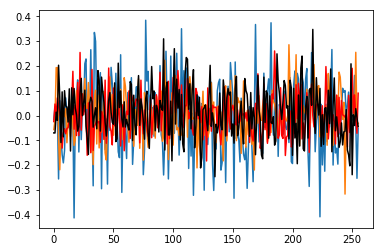

Epoch:  12 Iteration:  5500 Loss:  0.323725


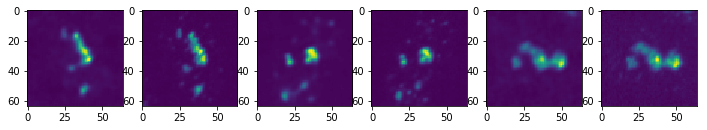

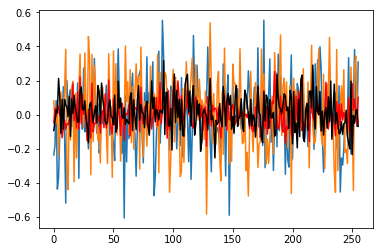

Epoch:  13 Iteration:  0 Loss:  0.353029


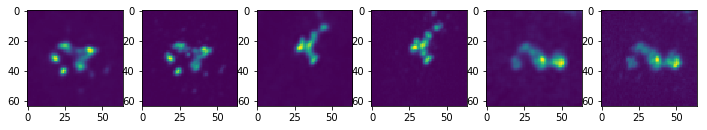

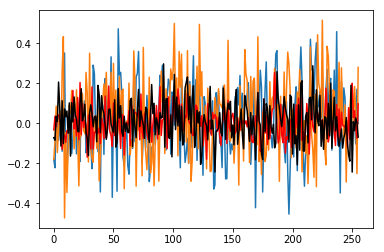

Epoch:  13 Iteration:  500 Loss:  0.412635


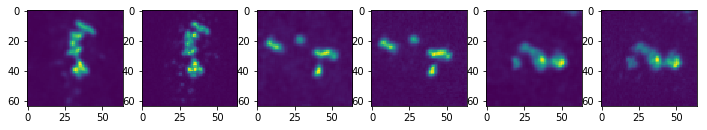

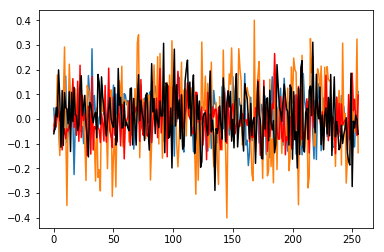

Epoch:  13 Iteration:  1000 Loss:  0.299391


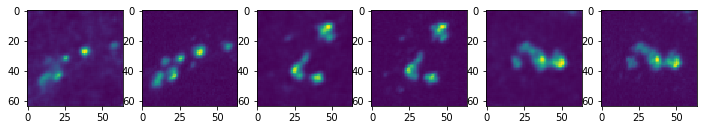

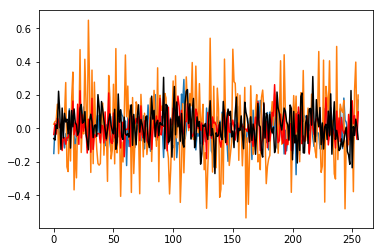

Epoch:  13 Iteration:  1500 Loss:  0.257589


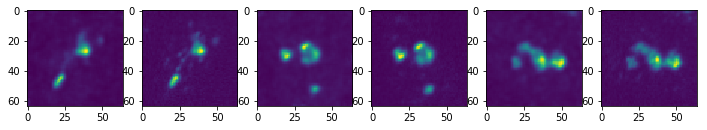

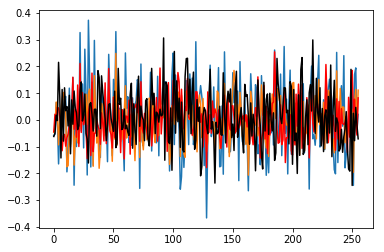

Epoch:  13 Iteration:  2000 Loss:  0.551165


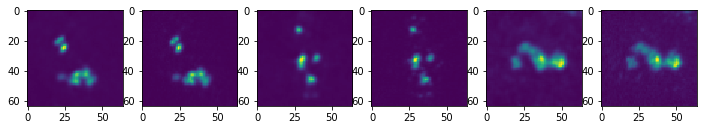

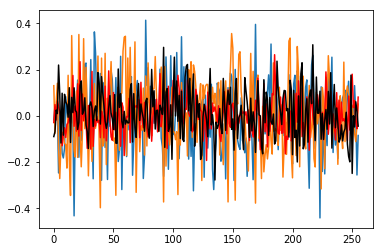

Epoch:  13 Iteration:  2500 Loss:  0.348011


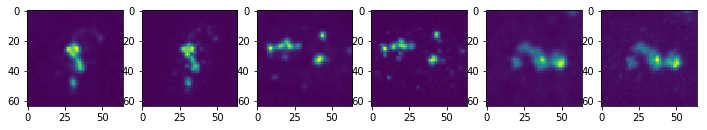

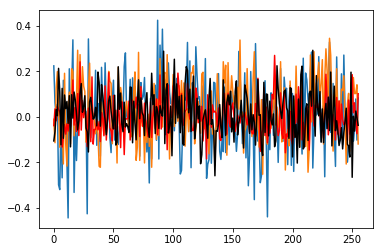

Epoch:  13 Iteration:  3000 Loss:  0.345378


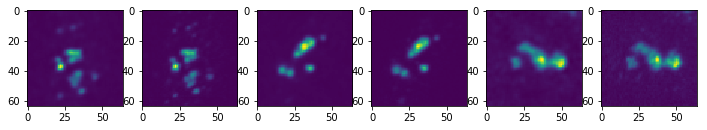

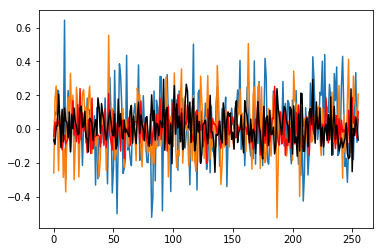

Epoch:  13 Iteration:  3500 Loss:  0.339172


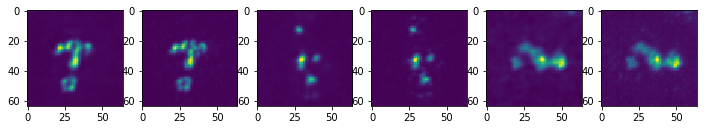

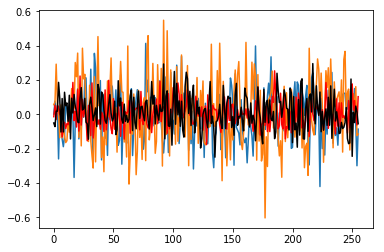

Epoch:  13 Iteration:  4000 Loss:  0.327811


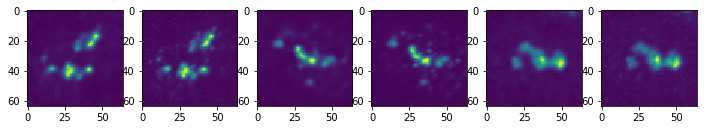

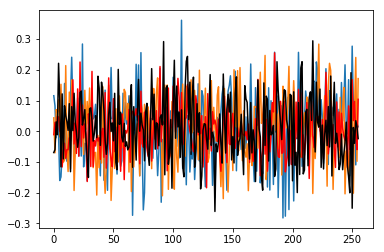

Epoch:  13 Iteration:  4500 Loss:  0.441248


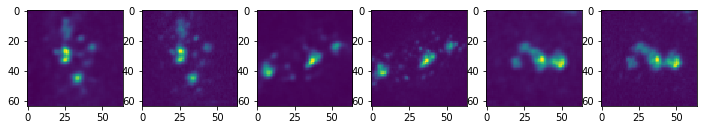

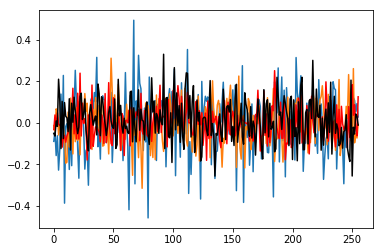

Epoch:  13 Iteration:  5000 Loss:  0.347323


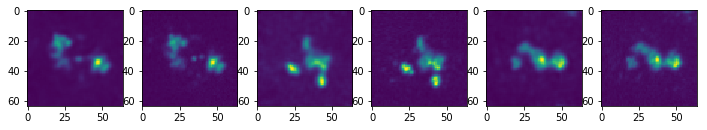

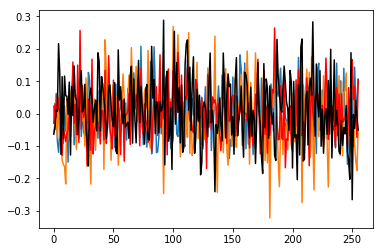

Epoch:  13 Iteration:  5500 Loss:  0.31547


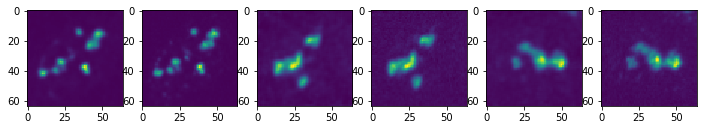

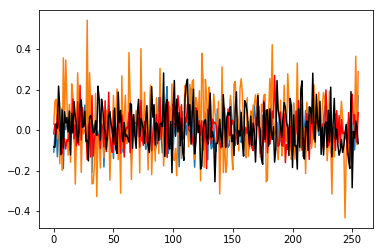

Epoch:  14 Iteration:  0 Loss:  0.337529


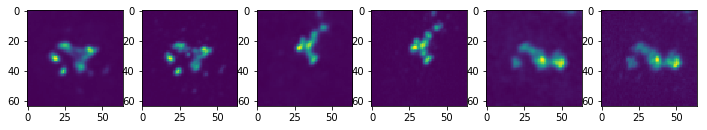

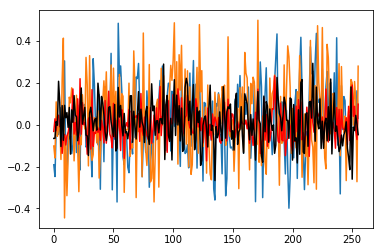

Epoch:  14 Iteration:  500 Loss:  0.390891


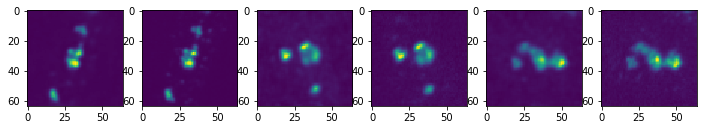

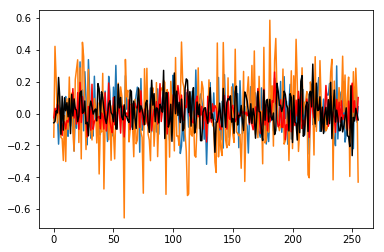

Epoch:  14 Iteration:  1000 Loss:  0.299288


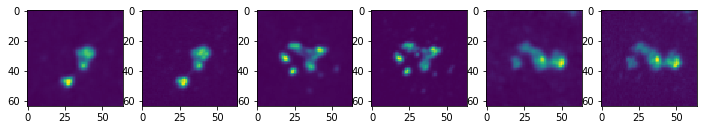

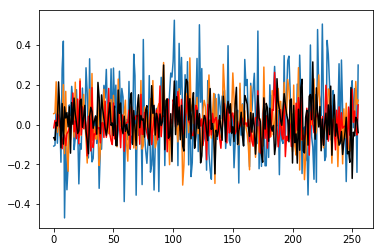

Epoch:  14 Iteration:  1500 Loss:  0.256862


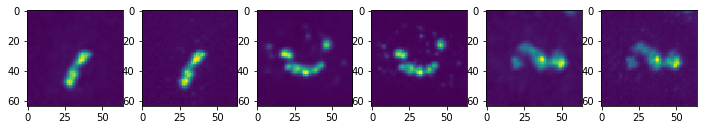

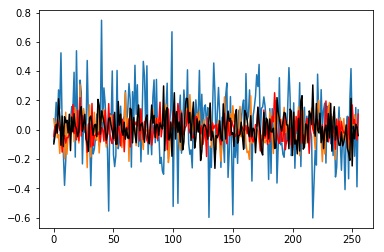

Epoch:  14 Iteration:  2000 Loss:  0.540077


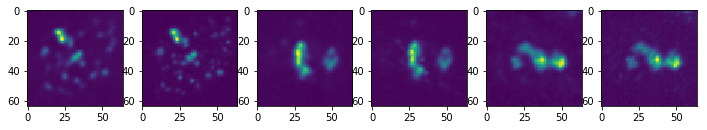

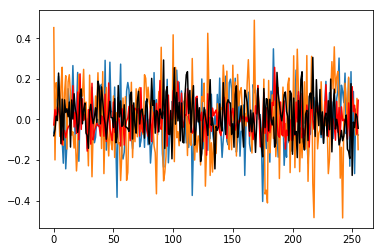

Epoch:  14 Iteration:  2500 Loss:  0.327745


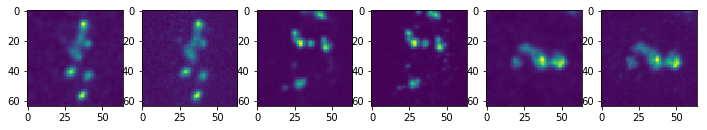

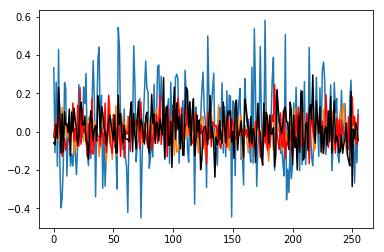

Epoch:  14 Iteration:  3000 Loss:  0.340379


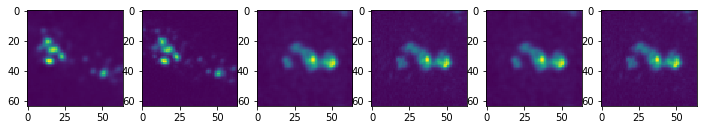

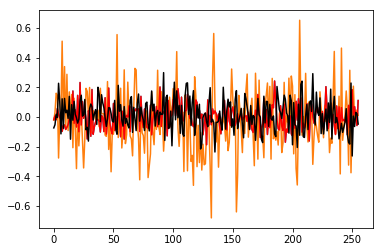

Epoch:  14 Iteration:  3500 Loss:  0.318784


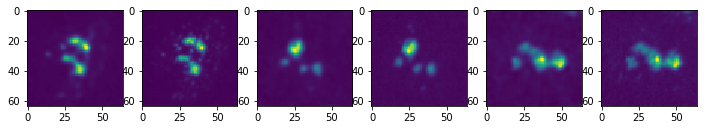

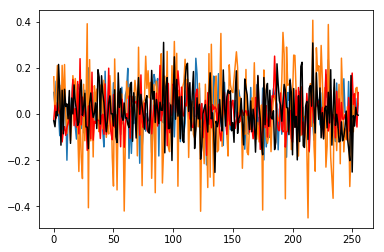

Epoch:  14 Iteration:  4000 Loss:  0.311551


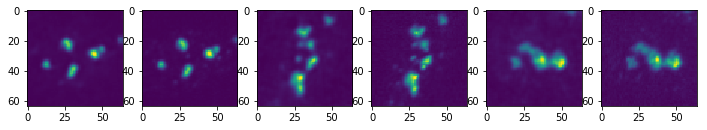

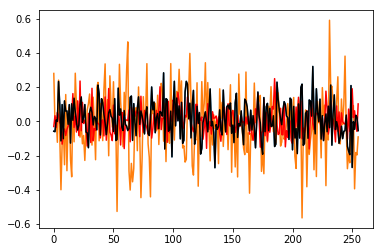

Epoch:  14 Iteration:  4500 Loss:  0.443214


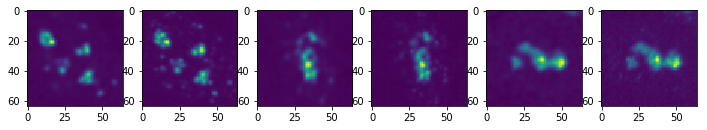

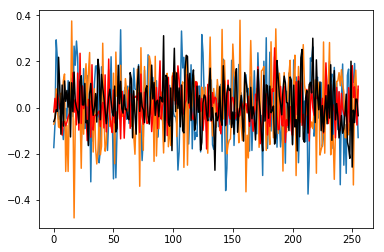

Epoch:  14 Iteration:  5000 Loss:  0.339643


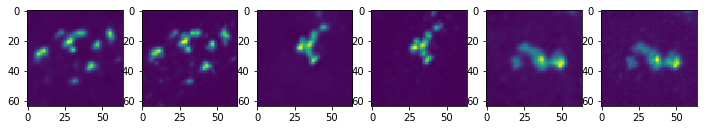

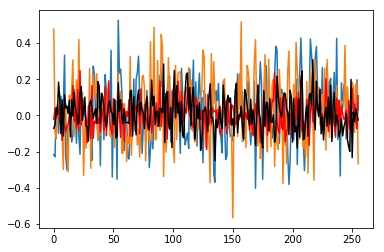

Epoch:  14 Iteration:  5500 Loss:  0.311852


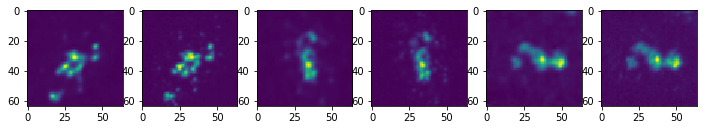

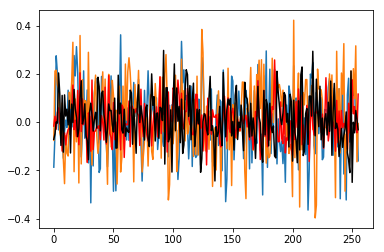

Epoch:  15 Iteration:  0 Loss:  0.336109


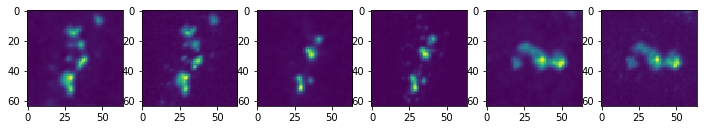

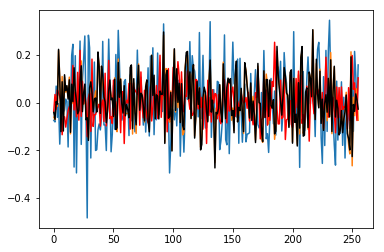

Epoch:  15 Iteration:  500 Loss:  0.369343


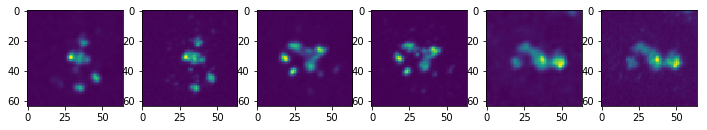

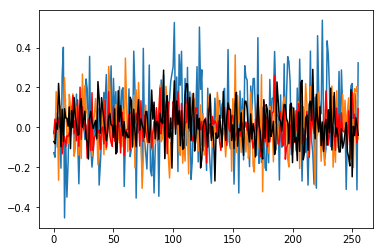

Epoch:  15 Iteration:  1000 Loss:  0.285991


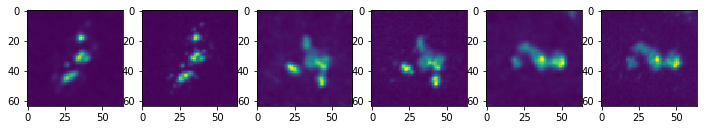

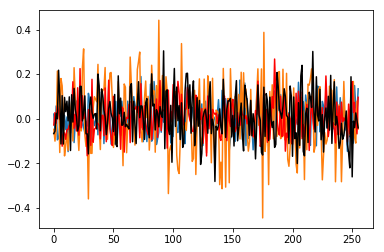

Epoch:  15 Iteration:  1500 Loss:  0.241474


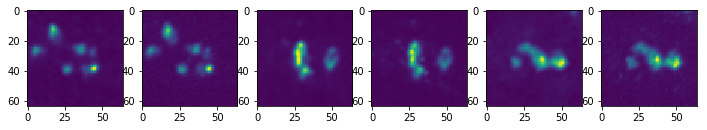

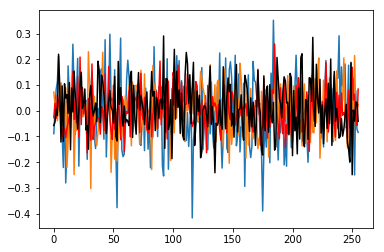

Epoch:  15 Iteration:  2000 Loss:  0.541101


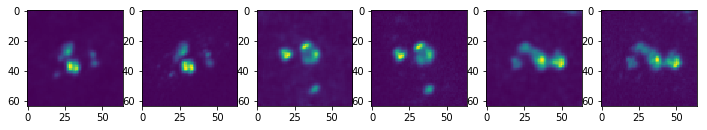

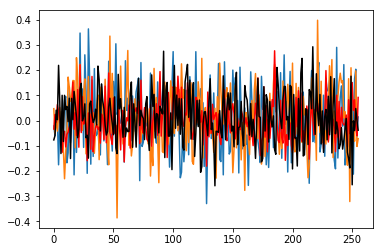

Epoch:  15 Iteration:  2500 Loss:  0.314709


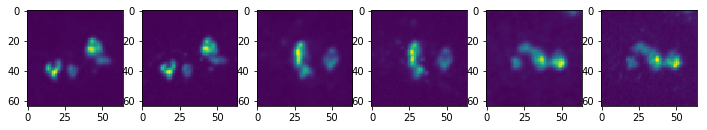

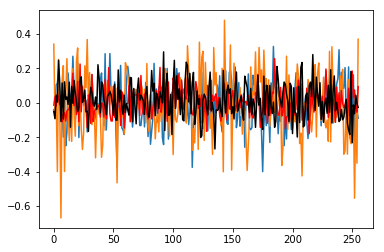

Epoch:  15 Iteration:  3000 Loss:  0.370284


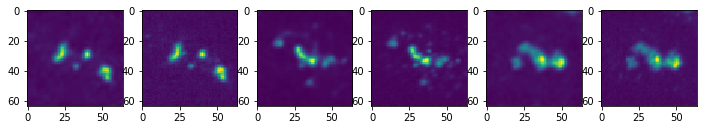

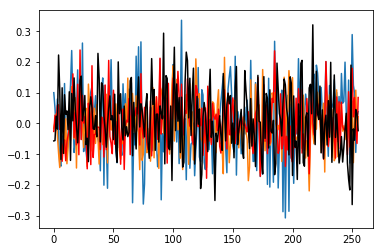

Epoch:  15 Iteration:  3500 Loss:  0.316516


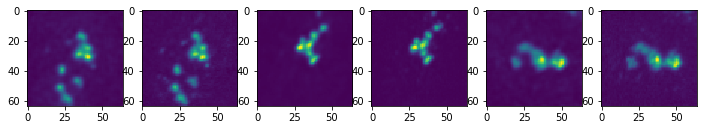

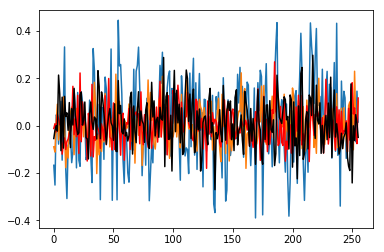

Epoch:  15 Iteration:  4000 Loss:  0.309257


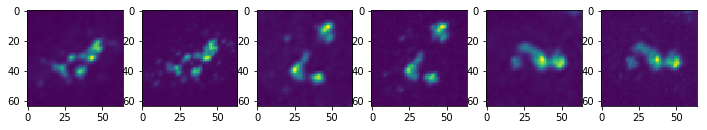

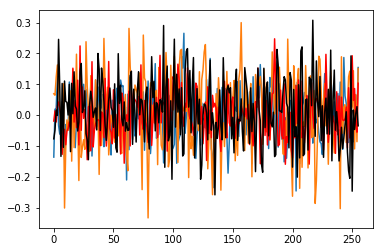

Epoch:  15 Iteration:  4500 Loss:  0.41671


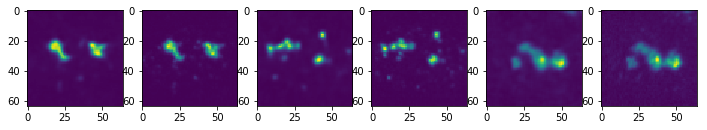

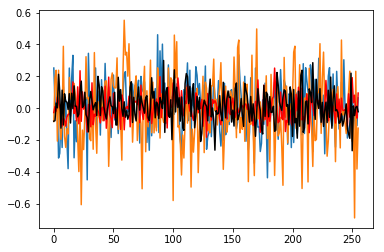

Epoch:  15 Iteration:  5000 Loss:  0.316774


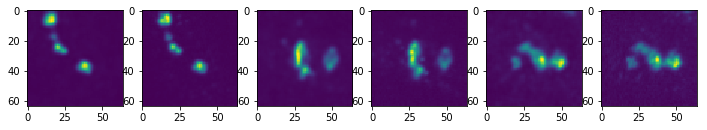

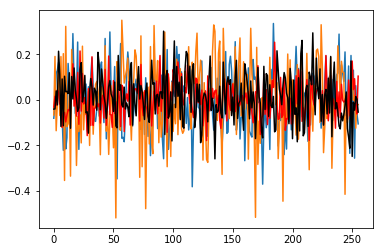

Epoch:  15 Iteration:  5500 Loss:  0.294627


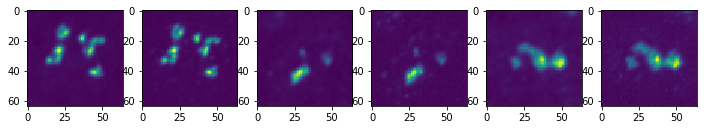

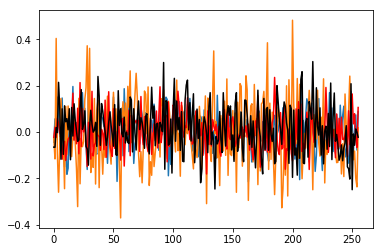

Epoch:  16 Iteration:  0 Loss:  0.322369


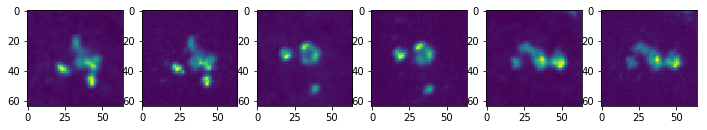

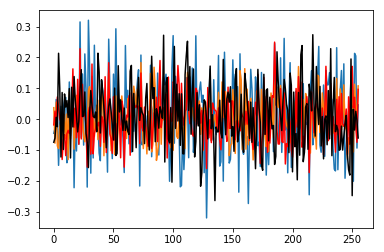

Epoch:  16 Iteration:  500 Loss:  0.361241


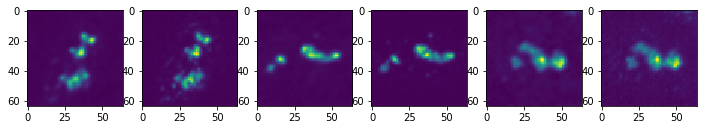

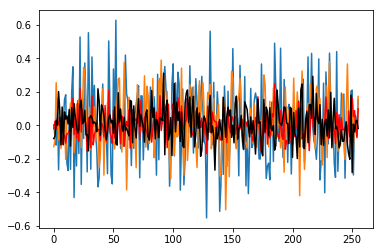

Epoch:  16 Iteration:  1000 Loss:  0.272614


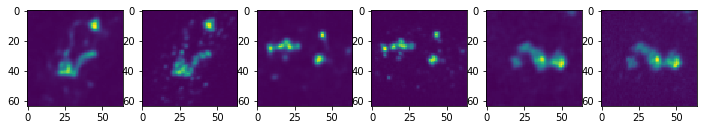

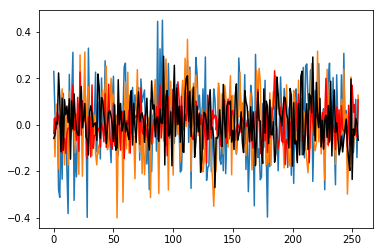

Epoch:  16 Iteration:  1500 Loss:  0.223014


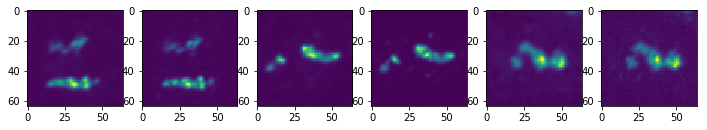

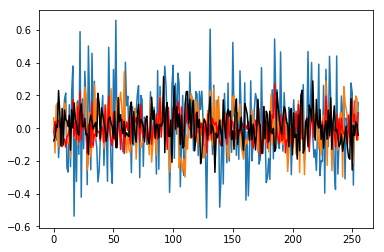

Epoch:  16 Iteration:  2000 Loss:  0.508212


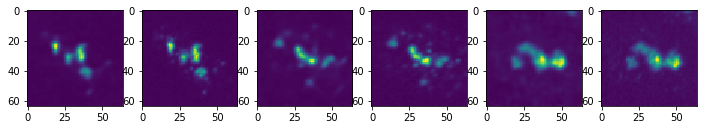

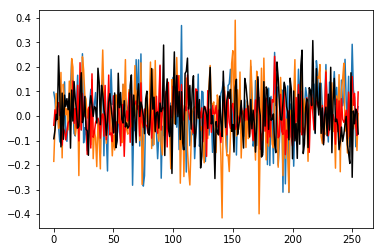

Epoch:  16 Iteration:  2500 Loss:  0.316805


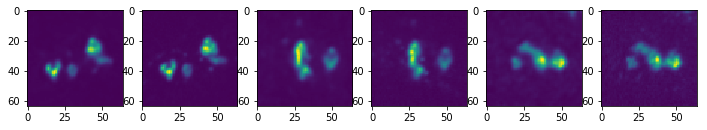

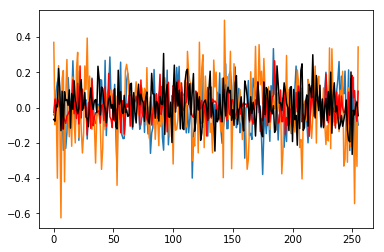

Epoch:  16 Iteration:  3000 Loss:  0.331219


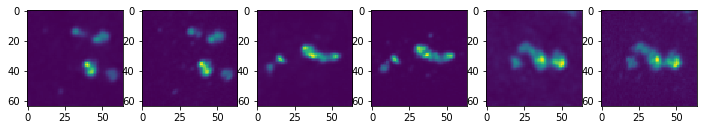

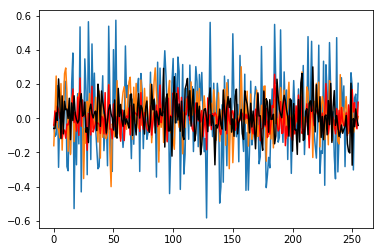

Epoch:  16 Iteration:  3500 Loss:  0.298121


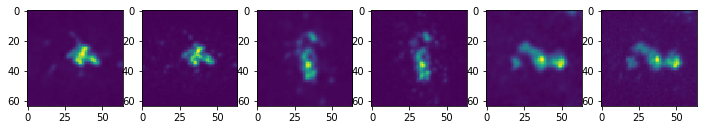

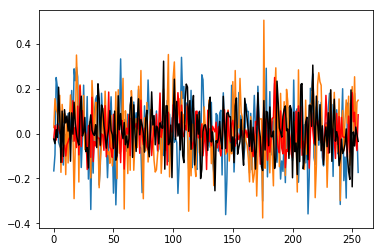

Epoch:  16 Iteration:  4000 Loss:  0.28919


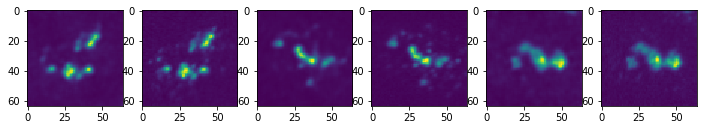

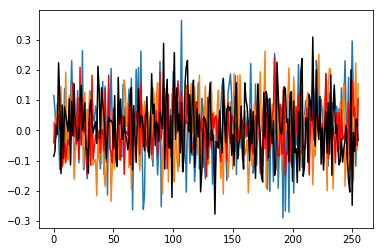

Epoch:  16 Iteration:  4500 Loss:  0.41328


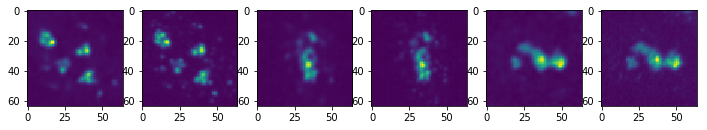

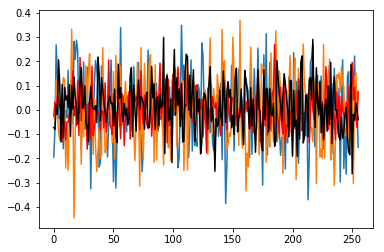

Epoch:  16 Iteration:  5000 Loss:  0.310703


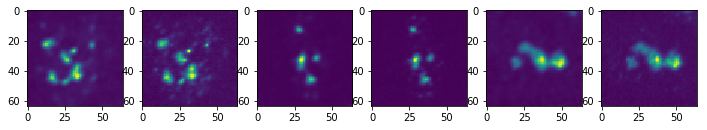

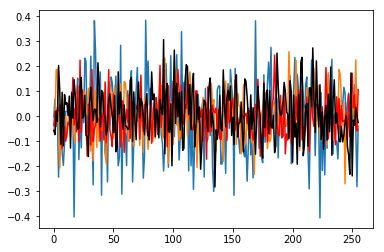

Epoch:  16 Iteration:  5500 Loss:  0.286106


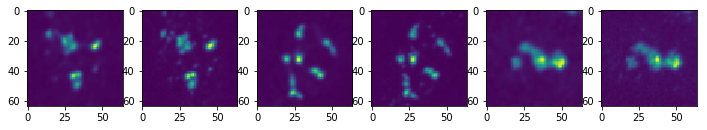

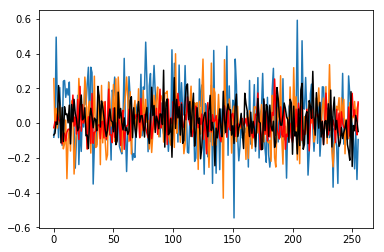

Epoch:  17 Iteration:  0 Loss:  0.305618


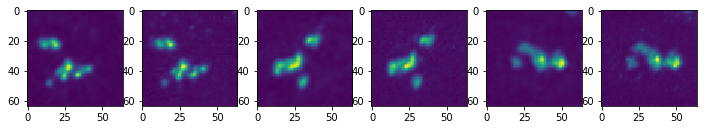

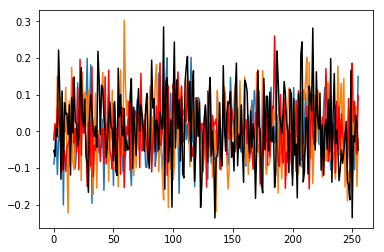

Epoch:  17 Iteration:  500 Loss:  0.356011


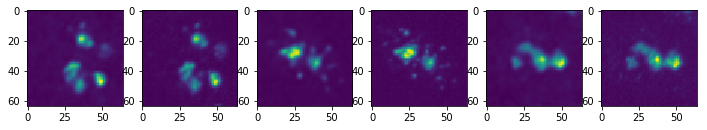

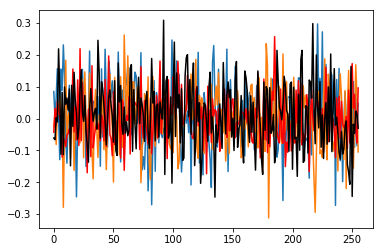

Epoch:  17 Iteration:  1000 Loss:  0.2635


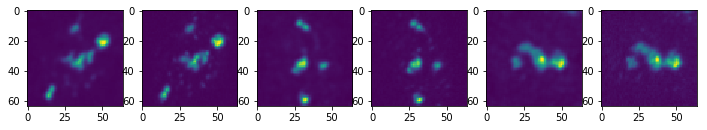

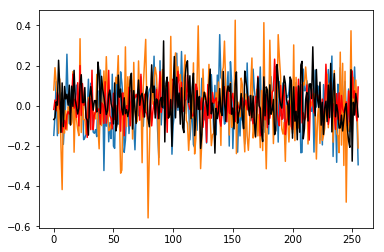

Epoch:  17 Iteration:  1500 Loss:  0.228013


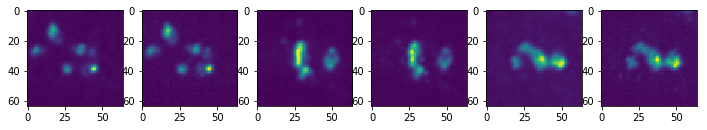

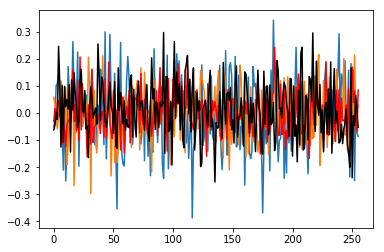

Epoch:  17 Iteration:  2000 Loss:  0.490014


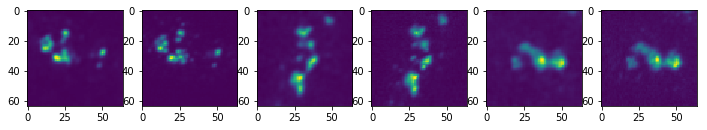

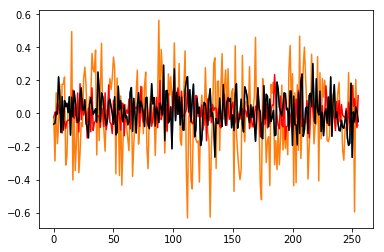

Epoch:  17 Iteration:  2500 Loss:  0.300196


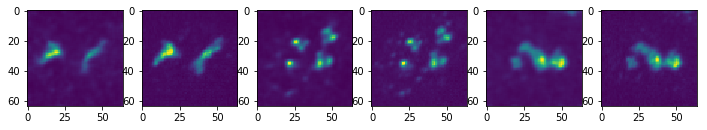

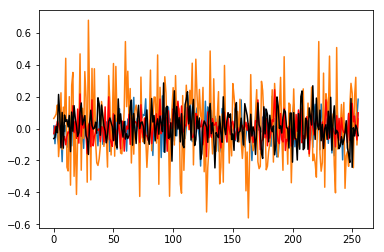

Epoch:  17 Iteration:  3000 Loss:  0.312999


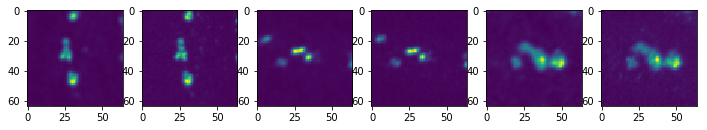

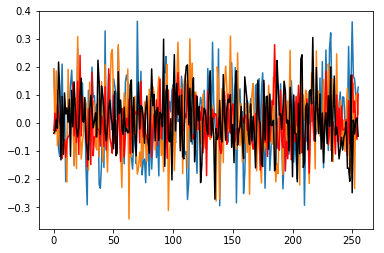

Epoch:  17 Iteration:  3500 Loss:  0.299655


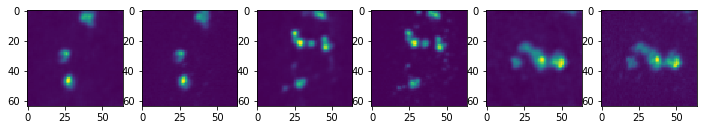

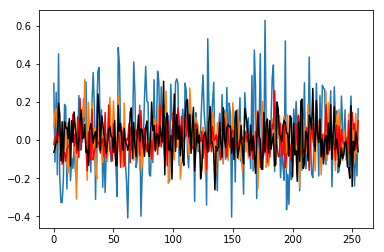

Epoch:  17 Iteration:  4000 Loss:  0.28027


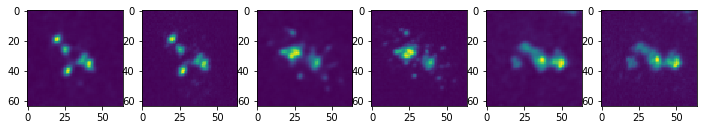

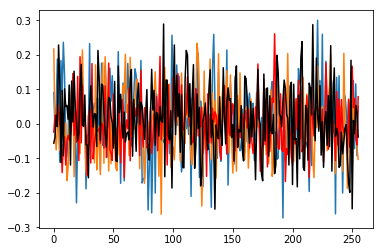

Epoch:  17 Iteration:  4500 Loss:  0.408098


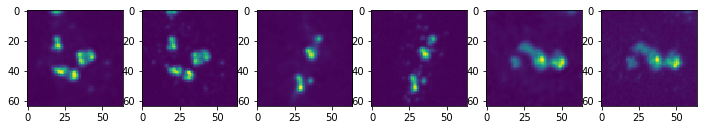

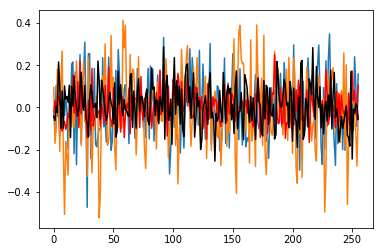

Epoch:  17 Iteration:  5000 Loss:  0.308669


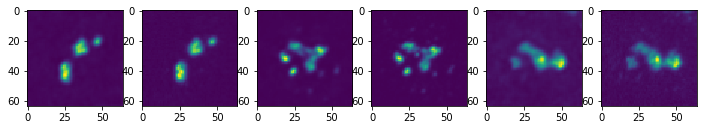

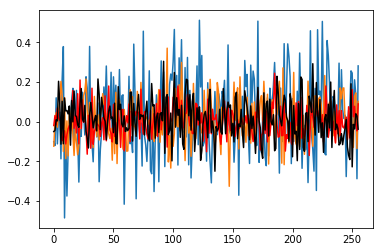

Epoch:  17 Iteration:  5500 Loss:  0.289271


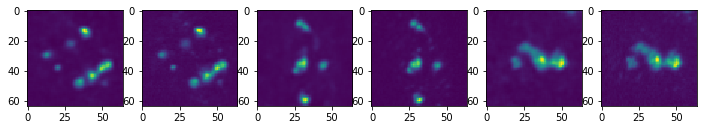

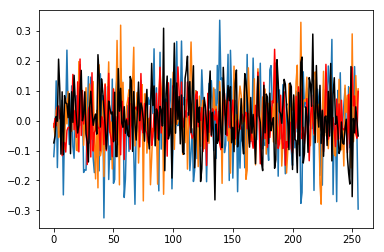

Epoch:  18 Iteration:  0 Loss:  0.31135


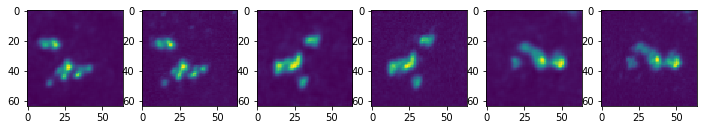

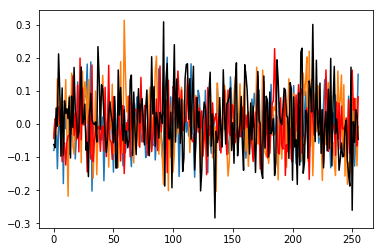

Epoch:  18 Iteration:  500 Loss:  0.359454


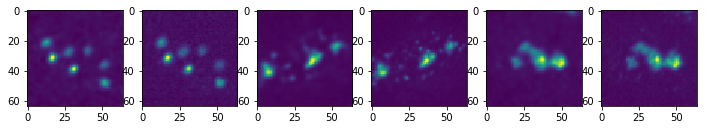

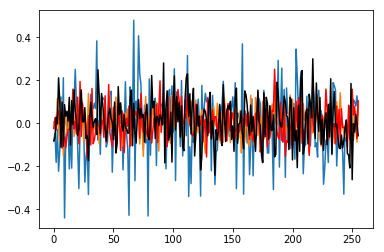

Epoch:  18 Iteration:  1000 Loss:  0.255452


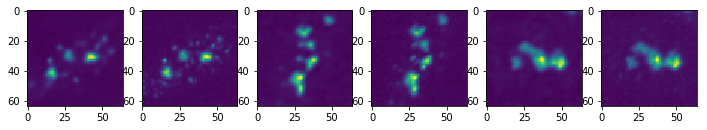

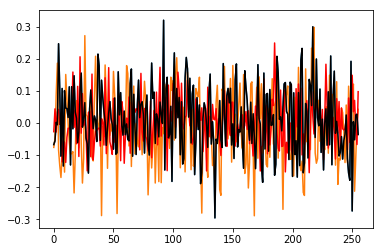

Epoch:  18 Iteration:  1500 Loss:  0.212392


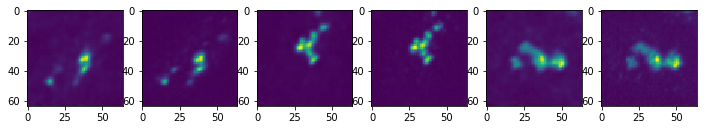

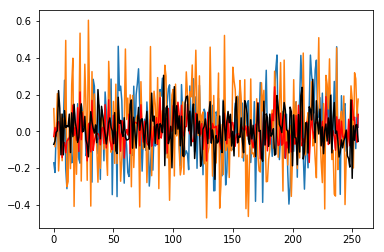

Epoch:  18 Iteration:  2000 Loss:  0.483248


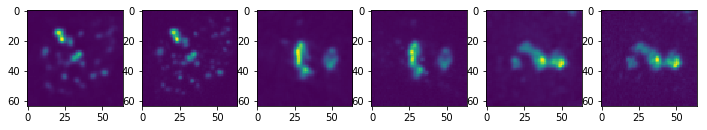

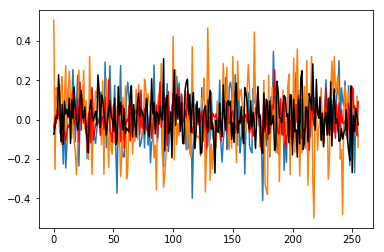

Epoch:  18 Iteration:  2500 Loss:  0.300038


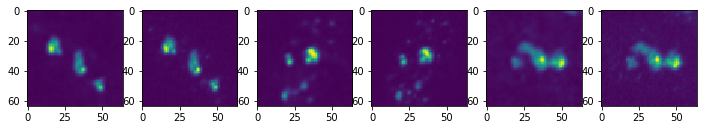

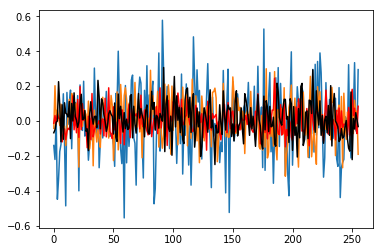

Epoch:  18 Iteration:  3000 Loss:  0.297005


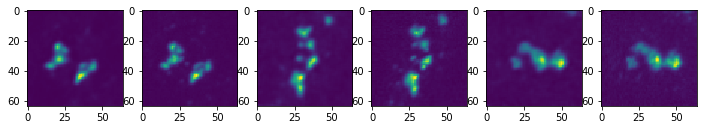

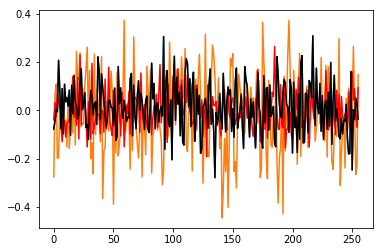

Epoch:  18 Iteration:  3500 Loss:  0.293265


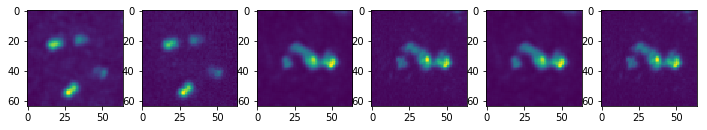

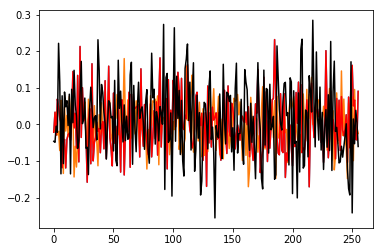

Epoch:  18 Iteration:  4000 Loss:  0.289889


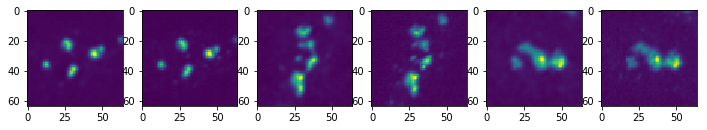

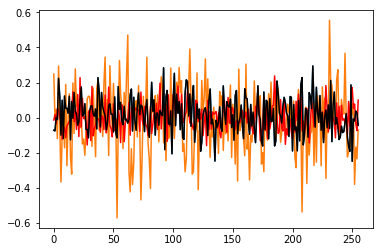

Epoch:  18 Iteration:  4500 Loss:  0.38634


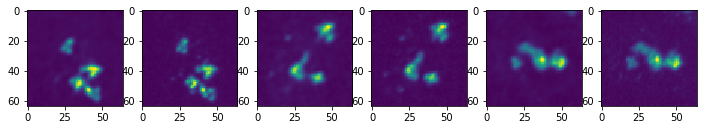

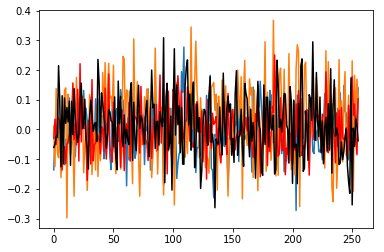

Epoch:  18 Iteration:  5000 Loss:  0.299134


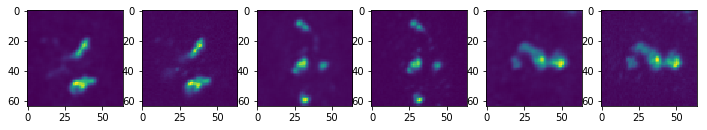

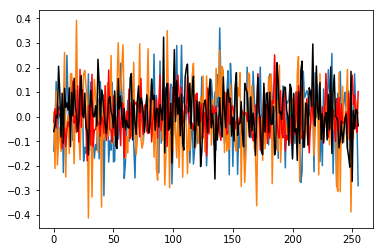

Epoch:  18 Iteration:  5500 Loss:  0.28401


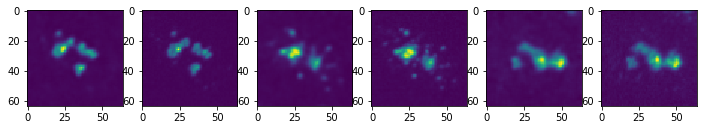

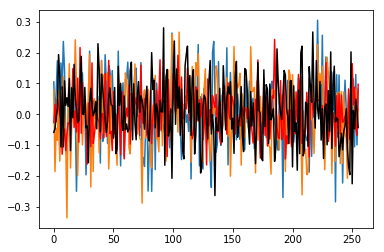

Epoch:  19 Iteration:  0 Loss:  0.285666


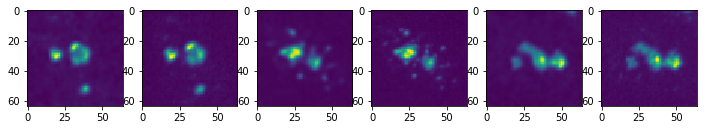

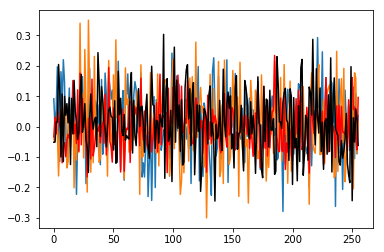

Epoch:  19 Iteration:  500 Loss:  0.330667


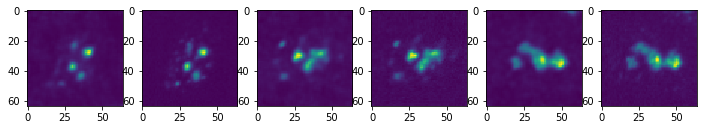

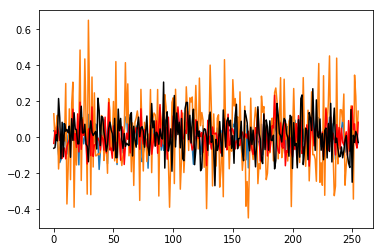

Epoch:  19 Iteration:  1000 Loss:  0.261291


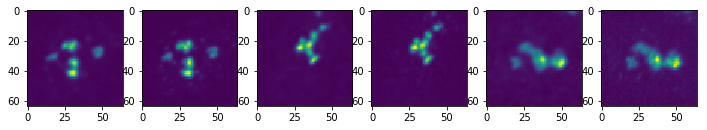

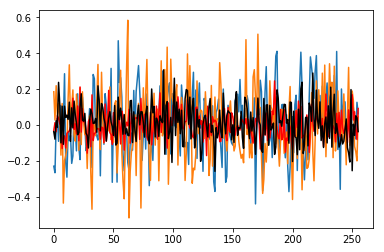

Epoch:  19 Iteration:  1500 Loss:  0.213638


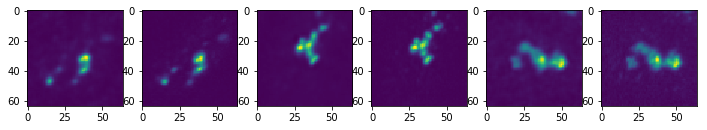

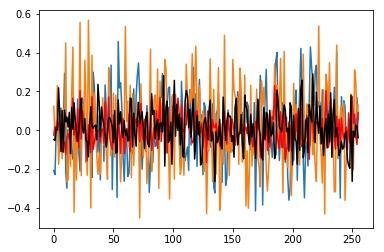

Epoch:  19 Iteration:  2000 Loss:  0.473405


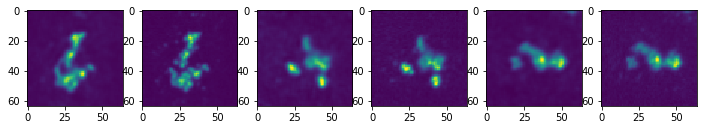

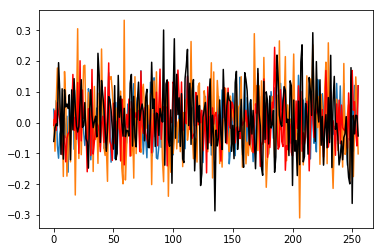

Epoch:  19 Iteration:  2500 Loss:  0.291936


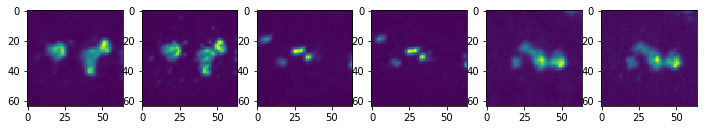

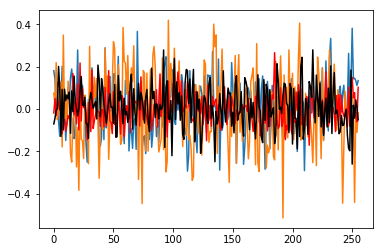

Epoch:  19 Iteration:  3000 Loss:  0.301666


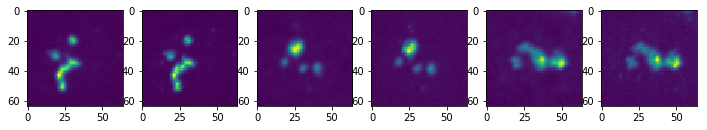

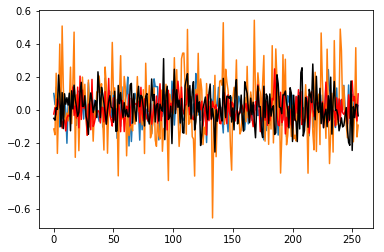

Epoch:  19 Iteration:  3500 Loss:  0.276823


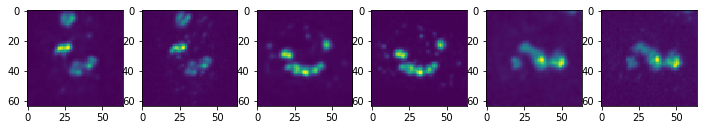

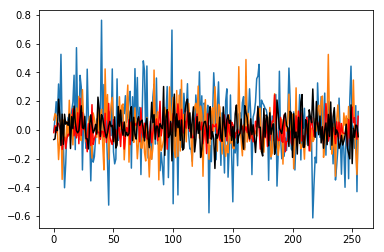

Epoch:  19 Iteration:  4000 Loss:  0.272161


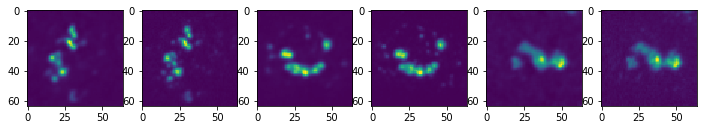

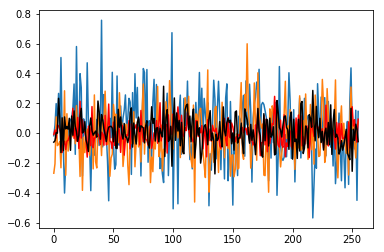

Epoch:  19 Iteration:  4500 Loss:  0.388264


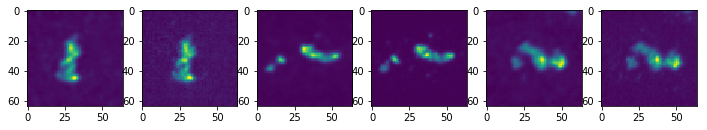

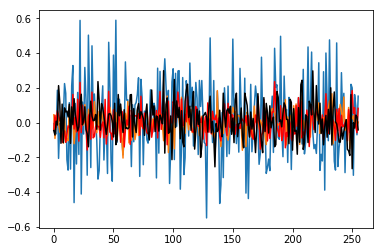

Epoch:  19 Iteration:  5000 Loss:  0.309503


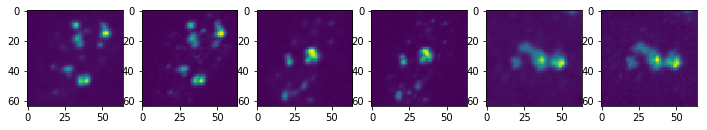

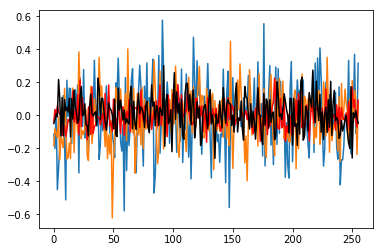

Epoch:  19 Iteration:  5500 Loss:  0.268164


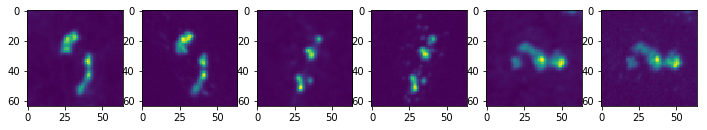

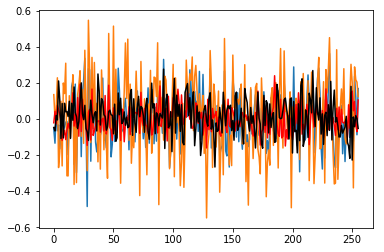

Done


In [4]:

#mf = p_df['mmfile']
#umf = list(mf.unique())
#print(umf)
#p_df = p_df.replace(umf, ["plate03_all.mm"])

#print(p_df.head())
# mmfilename = datadir + "memmaps/plate03_all.mm"
# mmheader = np.memmap(mmfilename, dtype="int32", mode='r',
#                     shape=(4,))

# header_shape = mmheader.shape
# xshape = (2400, mmheader[1], mmheader[2], mmheader[3])
# del mmheader

# m2 = np.memmap(mmfilename, dtype='float32', offset=128,
#               mode='r', shape=xshape)

p_mmdict = {"plate03_all.mm": m3,
            "plate04_all.mm": m4}

p_width = 64
p_height = 64
p_nchannels = 1
p_channels = [2]
p_nepochs = 20
p_batchsize = 32
p_learning_rate = 0.00005  #.0001
p_restore = False
p_latent_size = 256

# enc_sizes = [(8, 7), (16, 5), (32, 3), (64, 3)]
enc_sizes = [(64, 5), (128, 3), (256,3), (512,3)] #, (64, 3), (128,3)] #, (32, 3), (64, 3)]
dec_sizes = list(reversed(enc_sizes))
#dec_sizes.append((p_nchannels,7))

params = dict()

params['width'] = p_width
params['height'] = p_height
params['nchannels'] = p_nchannels
params['channels'] = p_channels
params['nepochs'] = p_nepochs
params['batchsize'] = p_batchsize
params['learning_rate'] = p_learning_rate
params['restore'] = p_restore
params['latent_size'] = p_latent_size
params['droprate'] = 0.95

params['enc_sizes'] = enc_sizes
params['dec_sizes'] = dec_sizes

autoencoder_train.train(p_mmdict, p_df, params, 500)